In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import trapz
from scipy.optimize import minimize
import pandas as pd

# Function to calculate nu(t) for a given shift, s, and k
def calculate_nu(t, s, k, shift_weeks=0):
    return alpha0 + k * np.exp(-s * (np.cos(np.pi * (t - shift_weeks*7) / 365 - varphi) ** 2))

# Define time range for one year (365 days)
t_one_year = np.arange(1.0, 366.0, 1)

# Initialize parameters
alpha0 = 2.77 / 30
varphi = 0.58
s_original = 31.02  # Initial value of s
k_original = 4.51 / 30  # Initial value of k

# Generate a range of s_desired values from s_original*1/4 to s_original*2
s_desired_values = np.linspace(s_original*1/4, s_original*2, num=20)

# Create an empty list to store results
results = []
# Calculate the integral of the original curve
nu_values_original = [calculate_nu(t_day, s_original, k_original) for t_day in t_one_year]
integral_original = trapz(nu_values_original, t_one_year)
print(f'Integral for Original s={s_original}, k={k_original}: {integral_original}')

# Loop through each s_desired value, optimize, and store results
for s_desired in s_desired_values:
    # Calculate the integral of the original curve
    nu_values_original = [calculate_nu(t_day, s_original, k_original) for t_day in t_one_year]
    integral_original = trapz(nu_values_original, t_one_year)

    # Function to minimize the difference in integral
    def integral_difference(params):
        s, k = params
        nu_values = [calculate_nu(t_day, s, k) for t_day in t_one_year]
        integral = trapz(nu_values, t_one_year)
        return abs(integral - integral_original)

    # Perform optimization to find the parameters that maintain the integral
    result = minimize(integral_difference, [s_desired, k_original], bounds=((0.01, 100), (0.01, 10)))

    s_optimal, k_optimal = result.x

    # Calculate and plot the original and new birth pulses with the optimized s and k
    nu_values_new = [calculate_nu(t_day, s_optimal, k_optimal) for t_day in t_one_year]

    # Append the results to the list
    results.append({'s_desired': s_desired, 'k_optimal': k_optimal, 'integral_optimal': trapz(nu_values_new, t_one_year)})

# Create a pandas dataframe from the results list
results_df = pd.DataFrame(results)

# Print the dataframe with results
print(results_df)
s_list = list(results_df['s_desired'])
k_list = list(results_df['k_optimal'])

Integral for Original s=31.02, k=0.15033333333333332: 39.21430900858337
    s_desired  k_optimal  integral_optimal
0    7.755000   0.075211         39.214309
1   10.612105   0.087292         39.214309
2   13.469211   0.098360         39.214309
3   16.326316   0.108440         39.214309
4   19.183421   0.117719         39.214309
5   22.040526   0.126346         39.214309
6   24.897632   0.134435         39.214309
7   27.754737   0.142073         39.214309
8   30.611842   0.149325         39.214309
9   33.468947   0.156253         39.214309
10  36.326053   0.162888         39.214309
11  39.183158   0.169262         39.214309
12  42.040263   0.175404         39.214309
13  44.897368   0.181339         39.214309
14  47.754474   0.187085         39.214309
15  50.611579   0.192660         39.214309
16  53.468684   0.198077         39.214309
17  56.325789   0.203351         39.214309
18  59.182895   0.208491         39.214309
19  62.040000   0.213507         39.214309


In [ ]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import numpy as np
from scipy.integrate import odeint
import pandas as pd  # Import Pandas
import numpy as np
from scipy import integrate
from scipy.integrate import odeint,solve_ivp
import sympy as sm
import matplotlib.pyplot as plt
#plt.rcParams['figure.figsize'] = [12, 6] #[W,H]
import pandas as pd
import matplotlib.pyplot as plt
from scipy.integrate import trapz
from scipy.optimize import minimize



### Model parameters from Hammed
alpha0=2.77/30 #5.12 #0.02
#alpha1=0.1
# k=4.51/30 # 55.60
# s=31.02 #26.04
varphi=0.58
Bjj=1.45e-3 # https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7529244/
Bja=1.45e-3
Baa=1.45e-3
Bc=(1.45e-3)/2
rho=0.1
theta=1.05
Tj=0.0166 #0.01063829787 from https://apps.who.int/iris/bitstream/handle/10665/261080/PMC2366655.pdf?sequence=1&isAllowed=y
# The age at first litter can be regarded as 94 days
mu_j=0.15
mu_a=1/(50) #1/339 ()#0.01 # 0.00663571428 from https://www.jstor.org/stable/1814 R. natalensis
#the death-rate was 0.1858 per head per 28 days (0.1858/28) =  0.00663571428
gamma_j=0.0457
gamma_a=0.0457 # https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7529244/
q = 0
###########

###### Time of integration ##################

t =np.arange(1.0, 366.0*1, 1)

# Model equations
def model(X, t, s, k):
    K= sum(initial) # Carrying capacity
 
    Sj,Ij,Cj,Rj,Sa,Ia,Ca,Ra = X #,N = X
    N = Sj+Ij+Cj+Rj+Sa+Ia+Ca+Ra

    s = s
    k = k
    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * (t) / 365 - varphi) ** 2))
    


    dSjdt = nu*(Sa+Ra+(1-rho)*(Ia+Ca))-((Bja*Ia+Bjj*Ij+Bc*(Cj+Ca))*Sj)/(N**q)-Tj*Sj-mu_j*Sj * (N/(K)) 
   

    dIjdt = ((Bja*Ia+Bjj*Ij+Bc*(Cj+Ca))*Sj)/(N**q)-Tj*Ij-gamma_j*Ij-mu_j*Ij * (N/(K)) 


    dCjdt = nu*(rho*(Ia+Ca))-Tj*Cj-theta*mu_j*Cj * (N/(K))

    dRjdt = gamma_j*Ij-Tj*Rj-mu_j*Rj * (N/(K))

    dSadt = Tj*Sj-((Baa*Ia+Bja*Ij+Bc*(Ca+Cj))*Sa)/(N**q)-mu_a*Sa * (N/(K))

    dIadt = ((Baa*Ia+Bja*Ij+Bc*(Cj+Ca))*Sa)/(N**q)-gamma_a*Ia-mu_a*Ia * (N/(K))

    dCadt = Tj*Cj-theta*mu_a*Ca * (N/(K))

    dRadt = gamma_a*Ia+Tj*Rj-mu_a*Ra * (N/(K))

    
    return [dSjdt, dIjdt, dCjdt, dRjdt, dSadt, dIadt, dCadt, dRadt]#, dNdt]# Create an array of shift values in weeks (both positive and negative)






all_results_df = pd.DataFrame()  # Create an empty DataFrame to store results

# keeping the orginal value of s and k 
s_list[8] = 31.02 
k_list[8] = 4.51/30
initial = []
# Loop through both s and k simultaneously
for s, k in zip(s_list, k_list):
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 200, 10, 5, 0, 500, 20, 10, 0
    initial = [Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra]
    
    # Simulate the model
    X = odeint(model, initial, t, args=(s, k))

    # Convert simulation results to a Pandas DataFrame
    result_df = pd.DataFrame(X, columns=['Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])
    
    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * (t) / 365 - varphi) ** 2))
    # Add a new column for nu value
    result_df['nu'] = nu

    # Add a new column for s value
    result_df['s'] = s
    
    # Add the 't' values as the first column
    result_df.insert(0, 'Time', t)

    # Append the simulation's DataFrame to the main DataFrame
    all_results_df = pd.concat([all_results_df, result_df], ignore_index=True)
    

# Save the results to a CSV file for easy access
all_results_df.to_csv('simulation_variations_width_birth_pulse.csv', index=False)

# # Visualize time series for 'Sj' for different 's' values
# plt.figure(figsize=(12, 6))
# for s_value, data in data_by_s.items():
#     plt.plot(data['t'], data['Sj'], label=f's = {s_value}')

# plt.xlabel('Time (t)')
# plt.ylabel('Sj')
# plt.legend()
# plt.title('Time Series of Sj for Different s Values')
# plt.show()
all_results_df

,Time,Sj,Ij,Cj,Rj,Sa,Ia,Ca,Ra,nu,s
0,1.0,200.000000,10.000000,5.000000,0.000000,500.000000,20.000000,10.000000,0.000000,0.092645,7.755
1,2.0,197.353292,24.133841,4.604024,0.684233,451.974423,59.295996,9.869775,1.689846,0.092626,7.755
2,3.0,175.451998,53.606864,4.751900,2.168931,365.249398,134.668733,9.739017,5.921247,0.092609,7.755
3,4.0,134.786330,97.629199,5.662313,5.011227,244.646498,239.428505,9.619318,14.283927,0.092593,7.755
4,5.0,92.442004,139.460979,7.292628,9.294373,132.565714,330.671336,9.523789,27.158963,0.092579,7.755
...,...,...,...,...,...,...,...,...,...,...,...
7295,361.0,72.545507,75.665579,2.348305,37.474223,7.826180,20.181049,4.252394,155.602373,0.092333,62.040
7296,362.0,72.541811,75.654408,2.348291,37.473823,7.826388,20.180205,4.246353,155.576718,0.092333,62.040
7297,363.0,72.538329,75.643395,2.348240,37.473314,7.826679,20.179302,4.240381,155.551470,0.092333,62.040
7298,364.0,72.535036,75.632549,2.348155,37.472708,7.827041,20.178354,4.234477,155.526617,0.092333,62.040


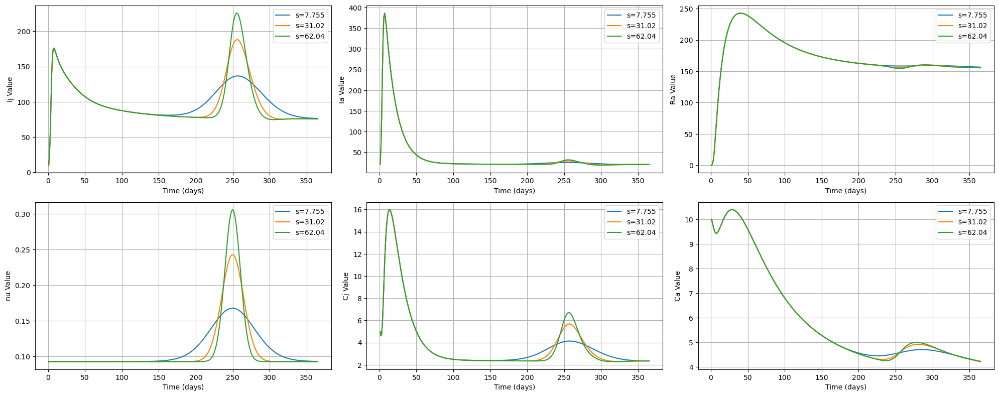

In [3]:
import matplotlib.pyplot as plt
# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]

# Create a figure with two rows and two columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 8))

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

# Create a plot for each 's' group for Ij in the first column (top row)
for s, group in grouped_data:
    axes[0, 0].plot(group['Time'], group['Ij'], label=f's={s}')
    axes[0, 1].plot(group['Time'], group['Ia'], label=f's={s}')
    axes[0, 2].plot(group['Time'], group['Ra'], label=f's={s}')
    axes[1, 0].plot(group['Time'], group['nu'], label=f's={s}')
    axes[1, 1].plot(group['Time'], group['Cj'], label=f's={s}')
    axes[1, 2].plot(group['Time'], group['Ca'], label=f's={s}')



# Add grids to all subplots
for ax in axes.flatten():
    ax.grid(True)

# Customize the first subplot (Ij)
axes[0, 0].set_xlabel('Time (days)')
axes[0, 0].set_ylabel('Ij Value')
#axes[0, 0].set_title('Effect of Changing "s" on Time Series (Ij)')
axes[0, 0].legend()
#xes[0, 0].grid(True)

# Customize the second subplot (Ia)
axes[0, 1].set_xlabel('Time (days)')
axes[0, 1].set_ylabel('Ia Value')
#axes[0, 1].set_title('Effect of Changing "s" on Time Series (Ia)')
axes[0, 1].legend()

# Customize the subplot (Ia)
axes[0, 2].set_xlabel('Time (days)')
axes[0, 2].set_ylabel('Ra Value')
axes[0, 2].legend()

# Customize the third subplot (nu)
axes[1, 0].set_xlabel('Time (days)')
axes[1, 0].set_ylabel('nu Value')
#axes[1, 0].set_title('Effect of Changing "s" on Time Series (nu)')
axes[1, 0].legend()

# Customize the fourth subplot (Cj)
axes[1, 1].set_xlabel('Time (days)')
axes[1, 1].set_ylabel('Cj Value')
#axes[1, 1].set_ylim(0, 15)
axes[1, 1].legend()

# Customize the subplot (Cj)
axes[1, 2].set_xlabel('Time (days)')
axes[1, 2].set_ylabel('Ca Value')
#axes[1, 2].set_ylim(0, 15)
axes[1, 2].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show or save the plot
plt.show()


Peak value at x = 3.0: Curve 1: 0.11106003812412972, Curve 2: 0.05553001906206486
Width at half maximum: Curve 1: 9.797979797979798, Curve 2: 9.797979797979798


In [68]:
import numpy as np

# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-3]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]

# Define your desired interval of x-values (time)
start_time = 150
end_time = 350

# Initialize dictionaries to store the maximum y-values and their corresponding x-values for each 's' group
max_y_values = {}
x_at_max_y_values = {}

max_nu_values = {}
x_at_max_nu_values = {}

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

for s, group in grouped_data:
    # Filter the data within the specified time interval
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]

    if not interval_data.empty:
        # Find the index of the maximum y-value within the interval for 'Ij'
        peak_index = np.argmax(interval_data['Ij'])
        max_y_within_interval = interval_data['Ij'].iloc[peak_index]
        # Find the index of the maximum y-value within the interval for 'nu'
        peak_index_nu = np.argmax(interval_data['nu'])
        max_nu_within_interval = interval_data['nu'].iloc[peak_index_nu]

        # Store the maximum y-value and its corresponding x-value for this 's' group for 'Ij'
        max_y_values[s] = max_y_within_interval
        x_at_max_y_values[s] = interval_data['Time'].iloc[peak_index]
        # Store the maximum y-value and its corresponding x-value for this 's' group for 'nu'
        max_nu_values[s] = max_nu_within_interval
        x_at_max_nu_values[s] = interval_data['Time'].iloc[peak_index_nu]

# Print the results for each 's' group for 'Ij'
for s, max_y in max_y_values.items():
    x_at_max_y = x_at_max_y_values[s]
    print(f"For 's' = {s}, the maximum value of 'Ij' within the interval [{start_time}, {end_time}] occurs at x = {x_at_max_y} with a value of {max_y}")

# Print the results for each 's' group for 'nu'
for s, max_nu in max_nu_values.items():
    x_at_max_nu = x_at_max_nu_values[s]
    print(f"For 's' = {s}, the maximum value of 'nu' within the interval [{start_time}, {end_time}] occurs at x = {x_at_max_nu} with a value of {max_nu}")

# Check if no data points were found within the specified interval for any 's' group
if not max_y_values:
    print(f"No data points found within the specified interval for any 's' group for 'Ij'.")
if not max_nu_values:
    print(f"No data points found within the specified interval for any 's' group for 'nu'.")


For 's' = 7.755, the maximum value of 'Ij' within the interval [150, 350] occurs at x = 258.0 with a value of 209.01614941012528
For 's' = 31.02, the maximum value of 'Ij' within the interval [150, 350] occurs at x = 258.0 with a value of 304.2851380787927
For 's' = 56.3257894736842, the maximum value of 'Ij' within the interval [150, 350] occurs at x = 258.0 with a value of 361.46290438748736
For 's' = 7.755, the maximum value of 'nu' within the interval [150, 350] occurs at x = 250.0 with a value of 0.1675442047619463
For 's' = 31.02, the maximum value of 'nu' within the interval [150, 350] occurs at x = 250.0 with a value of 0.24266219296678065
For 's' = 56.3257894736842, the maximum value of 'nu' within the interval [150, 350] occurs at x = 250.0 with a value of 0.29567296574788293


In [87]:
from scipy.interpolate import UnivariateSpline
for s, group in grouped_data:
    # Filter the data within the specified time interval
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]
    
    print("Max Ij:", interval_data['Ij'].max())
    
    # Find the index of the maximum 'Ij' value in interval_data
    max_idx = interval_data['Ij'].idxmax()

    # Get the corresponding 'Time' value
    corresponding_time = interval_data.loc[max_idx, 'Time']

    print("Corresponding Time:", corresponding_time)
    print('##################################')
    print('Full Width at Half Maximum (FWHM)')
    print('##################################')
    # Calculate the threshold as half of the maximum 'Ij' value
    threshold = interval_data['Ij'].max() / 2

    # Find the points above the threshold
    above_threshold = interval_data[interval_data['Ij'] >= threshold]

    # Calculate the width of the curve
    start_time_bump = above_threshold['Time'].min()
    end_time_bump = above_threshold['Time'].max()
    width_of_curve = end_time_bump - start_time_bump

    print("Start Time of Bump:", start_time_bump)
    print("End Time of Bump:", end_time_bump)
    print("Width of the Curve:", width_of_curve)
    

Max Ij: 209.01614941012528
Corresponding Time: 258.0
##################################
Full Width at Half Maximum (FWHM)
##################################
Start Time of Bump: 150.0
End Time of Bump: 350.0
Width of the Curve: 200.0
Max Ij: 304.2851380787927
Corresponding Time: 258.0
##################################
Full Width at Half Maximum (FWHM)
##################################
Start Time of Bump: 233.0
End Time of Bump: 286.0
Width of the Curve: 53.0
Max Ij: 361.46290438748736
Corresponding Time: 258.0
##################################
Full Width at Half Maximum (FWHM)
##################################
Start Time of Bump: 241.0
End Time of Bump: 278.0
Width of the Curve: 37.0


In [95]:
import numpy as np



# Group data by 's' for the filtered DataFrame
grouped_data = all_results_df.groupby('s')

for s, group in grouped_data:
    # Filter the data within the specified time interval
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]
    
    # Extract 'Ij' and 'nu' values
    ij_values = interval_data['Ij'].to_numpy()
    nu_values = interval_data['nu'].to_numpy()
    
    print("S:", s)
    
    print('##################################')
    print('Full Width at Half Maximum (FWHM) for Ij')
    print('##################################')
    
    # Calculate the threshold for 'Ij' as half of the maximum value
    max_ij = ij_values.max()
    threshold_ij = max_ij / 2

    # Find the points where 'Ij' is above the threshold
    above_threshold_ij = interval_data[interval_data['Ij'] >= threshold_ij]

    if not above_threshold_ij.empty:
        # Calculate the width of the curve for 'Ij'
        start_time_bump_ij = above_threshold_ij['Time'].min()
        end_time_bump_ij = above_threshold_ij['Time'].max()
        width_of_curve_ij = end_time_bump_ij - start_time_bump_ij

        print("Start Time of Bump for Ij:", start_time_bump_ij)
        print("End Time of Bump for Ij:", end_time_bump_ij)
        print("Width of the Curve for Ij:", width_of_curve_ij)
    else:
        print("No points found above the threshold for 'Ij'.")
    
    print('##################################')
    print('Full Width at Half Maximum (FWHM) for nu')
    print('##################################')
    
    # Calculate the threshold for 'nu' as half of the maximum value
    max_nu = nu_values.max()
    threshold_nu = max_nu / 2

    # Find the points where 'nu' is above the threshold
    above_threshold_nu = interval_data[interval_data['nu'] >= threshold_nu]

    if not above_threshold_nu.empty:
        # Calculate the width of the curve for 'nu'
        start_time_bump_nu = above_threshold_nu['Time'].min()
        end_time_bump_nu = above_threshold_nu['Time'].max()
        width_of_curve_nu = end_time_bump_nu - start_time_bump_nu

        print("Start Time of Bump for nu:", start_time_bump_nu)
        print("End Time of Bump for nu:", end_time_bump_nu)
        print("Width of the Curve for nu:", width_of_curve_nu)
    else:
        print("No points found above the threshold for 'nu'.")
    
    print('\n')  # Add a newline for clarity between different data sets


S: 7.755
##################################
Full Width at Half Maximum (FWHM) for Ij
##################################
Start Time of Bump for Ij: 150.0
End Time of Bump for Ij: 350.0
Width of the Curve for Ij: 200.0
##################################
Full Width at Half Maximum (FWHM) for nu
##################################
Start Time of Bump for nu: 150.0
End Time of Bump for nu: 350.0
Width of the Curve for nu: 200.0


S: 10.612105263157893
##################################
Full Width at Half Maximum (FWHM) for Ij
##################################
Start Time of Bump for Ij: 150.0
End Time of Bump for Ij: 317.0
Width of the Curve for Ij: 167.0
##################################
Full Width at Half Maximum (FWHM) for nu
##################################
Start Time of Bump for nu: 150.0
End Time of Bump for nu: 350.0
Width of the Curve for nu: 200.0


S: 13.469210526315788
##################################
Full Width at Half Maximum (FWHM) for Ij
##################################


In [98]:
import pandas as pd
import numpy as np

# Create an empty list to store DataFrames
result_dfs = []

# Group data by 's' for the filtered DataFrame
grouped_data = all_results_df.groupby('s')

for s, group in grouped_data:
    # Filter the data within the specified time interval
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]
    
    # Extract 'Ij' and 'nu' values
    ij_values = interval_data['Ij'].to_numpy()
    nu_values = interval_data['nu'].to_numpy()
    
    fwhm_ij_start, fwhm_ij_end, fwhm_ij_width = None, None, None
    fwhm_nu_start, fwhm_nu_end, fwhm_nu_width = None, None, None
    
    # Calculate the threshold for 'Ij' as half of the maximum value
    max_ij = ij_values.max()
    threshold_ij = max_ij / 2

    # Find the points where 'Ij' is above the threshold
    above_threshold_ij = interval_data[interval_data['Ij'] >= threshold_ij]

    if not above_threshold_ij.empty:
        # Calculate the width of the curve for 'Ij'
        start_time_bump_ij = above_threshold_ij['Time'].min()
        end_time_bump_ij = above_threshold_ij['Time'].max()
        width_of_curve_ij = end_time_bump_ij - start_time_bump_ij
        
        fwhm_ij_start = start_time_bump_ij
        fwhm_ij_end = end_time_bump_ij
        fwhm_ij_width = width_of_curve_ij

    # Calculate the threshold for 'nu' as half of the maximum value
    max_nu = nu_values.max()
    threshold_nu = max_nu / 2

    # Find the points where 'nu' is above the threshold
    above_threshold_nu = interval_data[interval_data['nu'] >= threshold_nu]

    if not above_threshold_nu.empty:
        # Calculate the width of the curve for 'nu'
        start_time_bump_nu = above_threshold_nu['Time'].min()
        end_time_bump_nu = above_threshold_nu['Time'].max()
        width_of_curve_nu = end_time_bump_nu - start_time_bump_nu
        
        fwhm_nu_start = start_time_bump_nu
        fwhm_nu_end = end_time_bump_nu
        fwhm_nu_width = width_of_curve_nu

    # Create a DataFrame for the current 's' value
    result_df = pd.DataFrame({
        'S': [s],
        'FWHM_Ij_Start': [fwhm_ij_start],
        'FWHM_Ij_End': [fwhm_ij_end],
        'FWHM_Ij_Width': [fwhm_ij_width],
        'FWHM_nu_Start': [fwhm_nu_start],
        'FWHM_nu_End': [fwhm_nu_end],
        'FWHM_nu_Width': [fwhm_nu_width]
    })

    result_dfs.append(result_df)

# Concatenate all the DataFrames into one
results_df = pd.concat(result_dfs, ignore_index=True)

# Print the resulting DataFrame
results_df


,S,FWHM_Ij_Start,FWHM_Ij_End,FWHM_Ij_Width,FWHM_nu_Start,FWHM_nu_End,FWHM_nu_Width
0,7.755000,150.0,350.0,200.0,150.0,350.0,200.0
1,10.612105,150.0,317.0,167.0,150.0,350.0,200.0
2,13.469211,208.0,306.0,98.0,188.0,311.0,123.0
3,16.326316,217.0,299.0,82.0,203.0,297.0,94.0
4,19.183421,222.0,295.0,73.0,210.0,290.0,80.0
5,22.040526,226.0,292.0,66.0,215.0,285.0,70.0
6,24.897632,229.0,289.0,60.0,218.0,281.0,63.0
7,27.754737,231.0,288.0,57.0,221.0,279.0,58.0
8,31.020000,233.0,286.0,53.0,223.0,276.0,53.0
9,33.468947,234.0,285.0,51.0,225.0,275.0,50.0


In [99]:
from ydata_profiling import ProfileReport
# Create a ProfileReport object
profile = ProfileReport(results_df)

# Generate the report
profile.to_file("data_profile_report_FWHM.html")  # This will save the report to an HTML file

# Display the report in Jupyter Notebook (optional)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
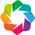

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (20, 7)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    7 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix data quality issues automatically, import FixDQ from autoviz...


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
S,float64,0.000000,NA,7.755000,62.040000,No issue
FWHM_Ij_Start,float64,0.000000,NA,150.000000,242.000000,has 2 outliers greater than upper bound (260.62) or lower than lower bound(203.62). Cap them or remove them.
FWHM_Ij_End,float64,0.000000,NA,277.000000,350.000000,"has 2 outliers greater than upper bound (312.25) or lower than lower bound(260.25). Cap them or remove them., has a high correlation with ['FWHM_Ij_Start']. Consider dropping one of them."
FWHM_Ij_Width,float64,0.000000,NA,35.000000,200.000000,"has 2 outliers greater than upper bound (108.62) or lower than lower bound(-0.38). Cap them or remove them., has a high correlation with ['FWHM_Ij_Start', 'FWHM_Ij_End']. Consider dropping one of them."
FWHM_nu_Start,float64,0.000000,NA,150.000000,234.000000,"has 2 outliers greater than upper bound (256.88) or lower than lower bound(187.88). Cap them or remove them., has a high correlation with ['S', 'FWHM_Ij_Start', 'FWHM_Ij_End', 'FWHM_Ij_Width']. Consider dropping one of them."
FWHM_nu_End,float64,0.000000,NA,266.000000,350.000000,"has 2 outliers greater than upper bound (312.50) or lower than lower bound(242.50). Cap them or remove them., has a high correlation with ['S', 'FWHM_Ij_Start', 'FWHM_Ij_End', 'FWHM_Ij_Width', 'FWHM_nu_Start']. Consider dropping one of them."
FWHM_nu_Width,float64,0.000000,NA,32.000000,200.000000,"has 2 outliers greater than upper bound (124.62) or lower than lower bound(-14.38). Cap them or remove them., has a high correlation with ['S', 'FWHM_Ij_Start', 'FWHM_Ij_End', 'FWHM_Ij_Width', 'FWHM_nu_Start', 'FWHM_nu_End']. Consider dropping one of them."


Number of All Scatter Plots = 28


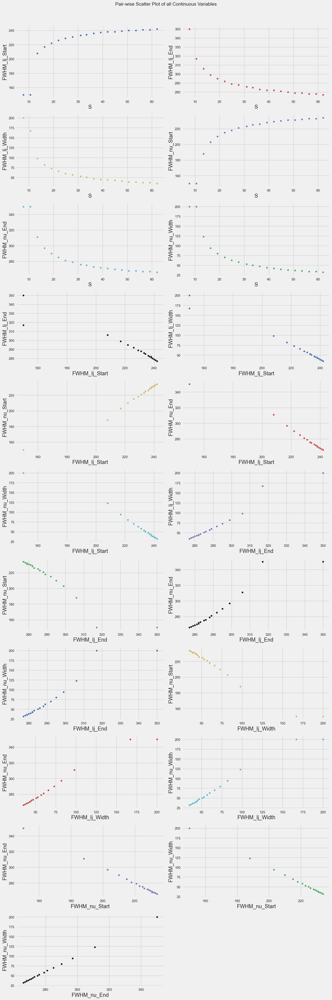

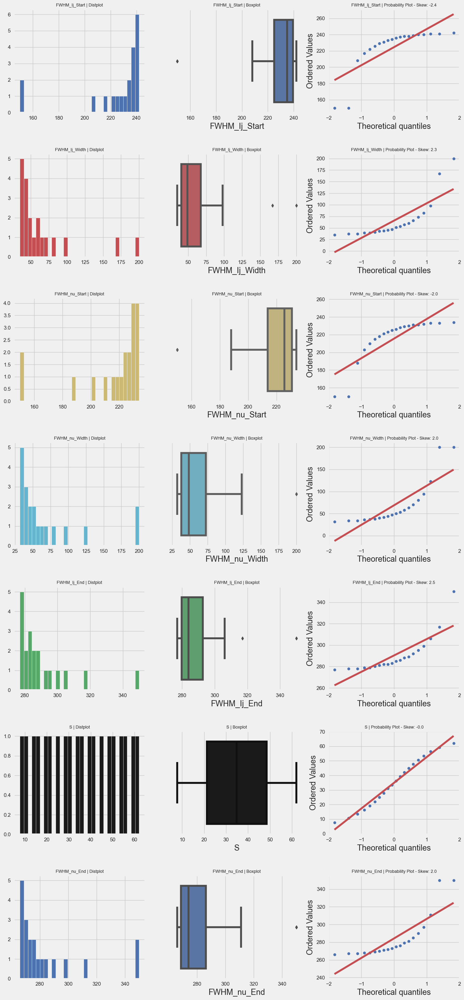

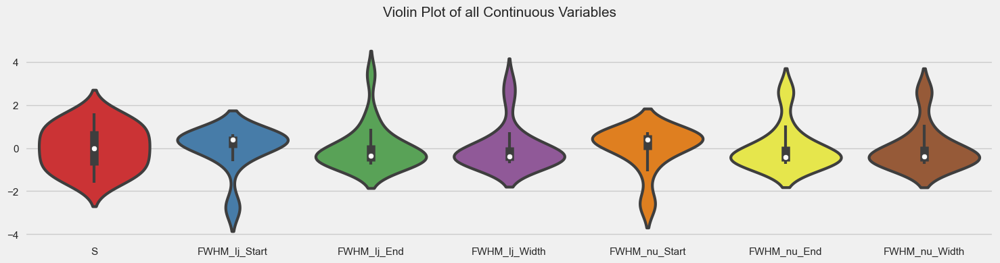

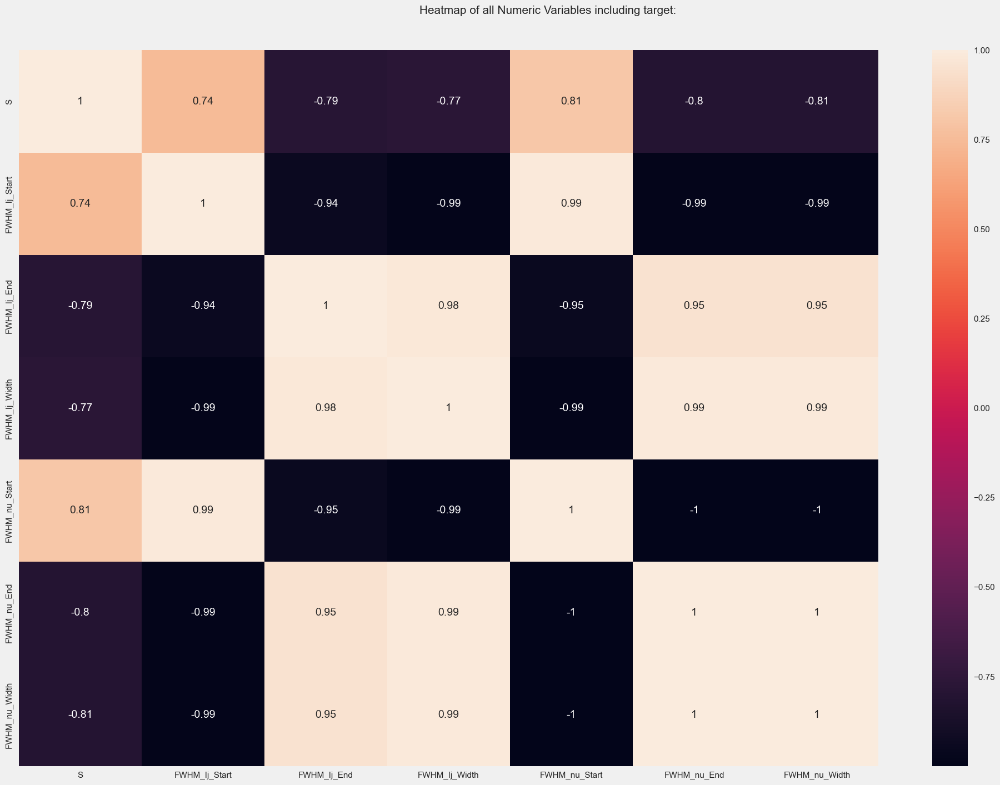

All Plots done
Time to run AutoViz = 4 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,S,FWHM_Ij_Start,FWHM_Ij_End,FWHM_Ij_Width,FWHM_nu_Start,FWHM_nu_End,FWHM_nu_Width
0,7.755000,150.0,350.0,200.0,150.0,350.0,200.0
1,10.612105,150.0,317.0,167.0,150.0,350.0,200.0
2,13.469211,208.0,306.0,98.0,188.0,311.0,123.0
3,16.326316,217.0,299.0,82.0,203.0,297.0,94.0
4,19.183421,222.0,295.0,73.0,210.0,290.0,80.0
5,22.040526,226.0,292.0,66.0,215.0,285.0,70.0
6,24.897632,229.0,289.0,60.0,218.0,281.0,63.0
7,27.754737,231.0,288.0,57.0,221.0,279.0,58.0
8,31.020000,233.0,286.0,53.0,223.0,276.0,53.0
9,33.468947,234.0,285.0,51.0,225.0,275.0,50.0


In [100]:
results_df.to_csv('results_df_FWHM.csv', index=False)
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline
AutoViz_Class().AutoViz("results_df_FWHM.csv")

In [71]:
import numpy as np
import pandas as pd
import scipy.optimize as opt

# Define the Gaussian fitting function
def gaussian(x, A, mu, sigma):
    return A * np.exp(-(x - mu)**2 / (2 * sigma**2))

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

for s, group in grouped_data:
    # Filter the data within the specified time interval
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]

    if not interval_data.empty:
        # Find the index of the maximum y-value within the interval for 'Ij'
        peak_index = np.argmax(interval_data['Ij'])
        max_y_within_interval = interval_data['Ij'].iloc[peak_index]
        # Find the index of the maximum y-value within the interval for 'nu'
        peak_index_nu = np.argmax(interval_data['nu'])
        max_nu_within_interval = interval_data['nu'].iloc[peak_index_nu]

        # Store the maximum y-value and its corresponding x-value for this 's' group for 'Ij'
        max_y_values[s] = max_y_within_interval
        x_at_max_y_values[s] = interval_data['Time'].iloc[peak_index]
        # Store the maximum y-value and its corresponding x-value for this 's' group for 'nu'
        max_nu_values[s] = max_nu_within_interval
        x_at_max_nu_values[s] = interval_data['Time'].iloc[peak_index_nu]
# Initialize dictionaries to store the peak widths for 'Ij' and 'nu'
peak_widths_ij = {}
peak_widths_nu = {}

# Loop through each 's' group
for s, group in grouped_data:
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]

    if not interval_data.empty:
        # Fit a Gaussian curve to 'Ij' data
        # Fit a Gaussian curve to 'Ij' data with increased maxfev and adjusted initial guesses
        popt_ij, _ = opt.curve_fit(gaussian, interval_data['Time'], interval_data['Ij'], p0=[300, 250, 5.0], maxfev=10000)

        # Extract the width from the optimized parameters
        peak_width_ij = popt_ij[2]

        # Fit a Gaussian curve to 'nu' data
        popt_nu, _ = opt.curve_fit(gaussian, interval_data['Time'], interval_data['nu'], p0=[0.5, 250, 5.0], maxfev=10000)
        # Extract the width from the optimized parameters
        peak_width_nu = popt_nu[2]

        # Store the peak widths in dictionaries
        peak_widths_ij[s] = peak_width_ij
        peak_widths_nu[s] = peak_width_nu

# Print the results for each 's' group
for s, width_ij in peak_widths_ij.items():
    print(f"For 's' = {s}, the width of the 'Ij' peak within the interval [{start_time}, {end_time}] is {width_ij}")

for s, width_nu in peak_widths_nu.items():
    print(f"For 's' = {s}, the width of the 'nu' peak within the interval [{start_time}, {end_time}] is {width_nu}")


For 's' = 7.755, the width of the 'Ij' peak within the interval [150, 350] is 78.46550377611035
For 's' = 31.02, the width of the 'Ij' peak within the interval [150, 350] is 60.8289713905934
For 's' = 56.3257894736842, the width of the 'Ij' peak within the interval [150, 350] is 57.570855559263734
For 's' = 7.755, the width of the 'nu' peak within the interval [150, 350] is 82.69264221456037
For 's' = 31.02, the width of the 'nu' peak within the interval [150, 350] is 66.27838361701778
For 's' = 56.3257894736842, the width of the 'nu' peak within the interval [150, 350] is 63.48362164714743


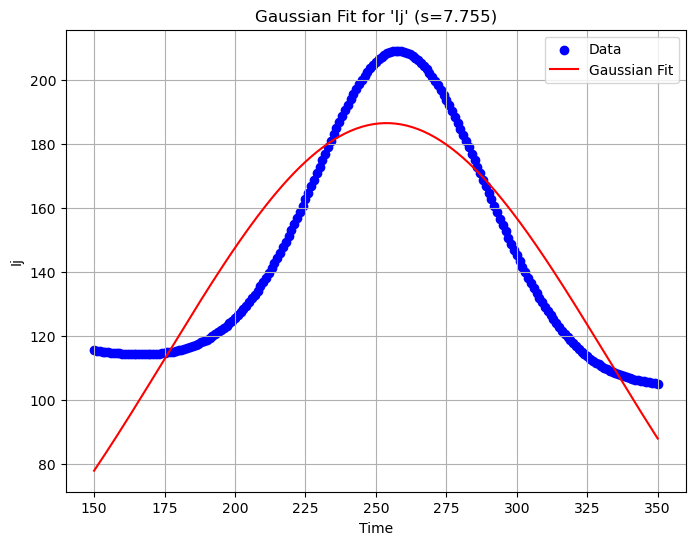

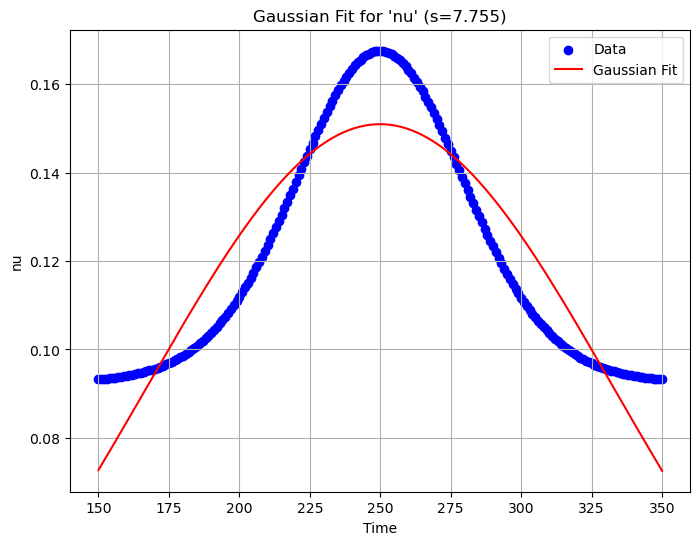

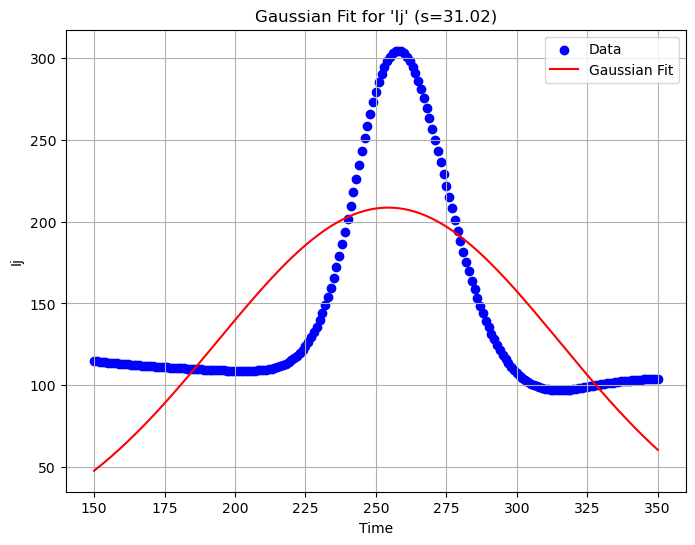

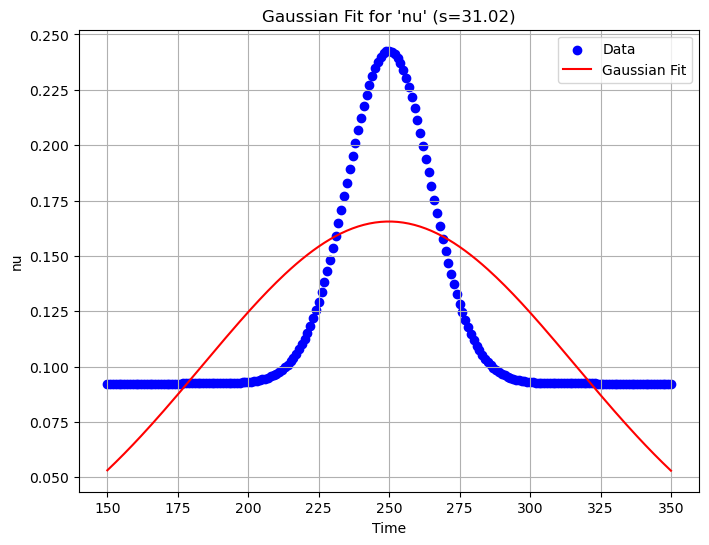

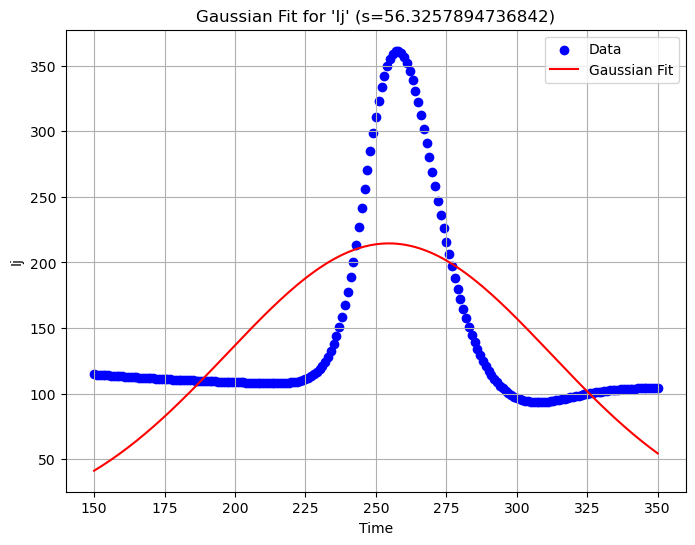

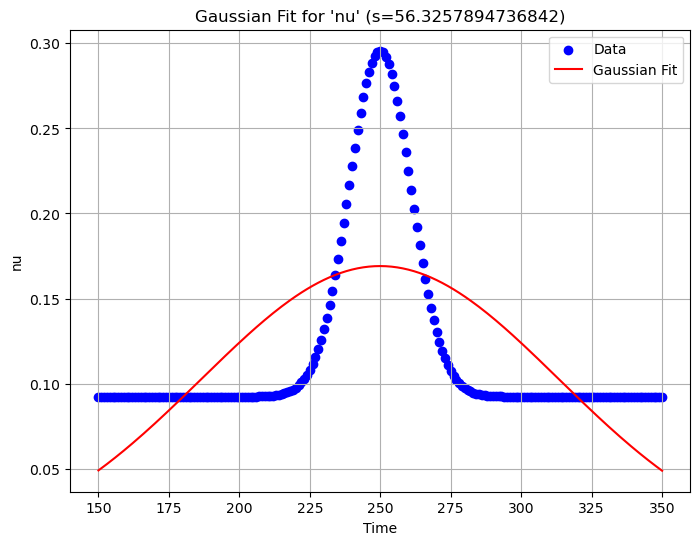

For 's' = 7.755, the width of the 'Ij' peak within the interval [150, 350] is 78.46550377611035
For 's' = 31.02, the width of the 'Ij' peak within the interval [150, 350] is 60.8289713905934
For 's' = 56.3257894736842, the width of the 'Ij' peak within the interval [150, 350] is 57.570855559263734
For 's' = 7.755, the width of the 'nu' peak within the interval [150, 350] is 82.69264221456037
For 's' = 31.02, the width of the 'nu' peak within the interval [150, 350] is 66.27838361701778
For 's' = 56.3257894736842, the width of the 'nu' peak within the interval [150, 350] is 63.48362164714743


In [73]:
import numpy as np
import pandas as pd
import scipy.optimize as opt
import matplotlib.pyplot as plt

# Define the Gaussian fitting function
def gaussian(x, A, mu, sigma):
    return A * np.exp(-(x - mu)**2 / (2 * sigma**2))

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

# Initialize dictionaries to store the peak widths for 'Ij' and 'nu'
peak_widths_ij = {}
peak_widths_nu = {}

# Loop through each 's' group
for s, group in grouped_data:
    mask = (group['Time'] >= start_time) & (group['Time'] <= end_time)
    interval_data = group[mask]

    if not interval_data.empty:
        # Fit a Gaussian curve to 'Ij' data
        popt_ij, _ = opt.curve_fit(gaussian, interval_data['Time'], interval_data['Ij'], p0=[300, 250, 5.0], maxfev=10000)

        # Extract the width from the optimized parameters
        peak_width_ij = popt_ij[2]

        # Fit a Gaussian curve to 'nu' data
        popt_nu, _ = opt.curve_fit(gaussian, interval_data['Time'], interval_data['nu'], p0=[0.5, 250, 5.0], maxfev=10000)
        # Extract the width from the optimized parameters
        peak_width_nu = popt_nu[2]

        # Store the peak widths in dictionaries
        peak_widths_ij[s] = peak_width_ij
        peak_widths_nu[s] = peak_width_nu

        # Plot 'Ij' data and the Gaussian fit
        plt.figure(figsize=(8, 6))
        plt.scatter(interval_data['Time'], interval_data['Ij'], label='Data', marker='o', color='blue')
        plt.plot(interval_data['Time'], gaussian(interval_data['Time'], *popt_ij), label='Gaussian Fit', color='red')
        plt.title(f"Gaussian Fit for 'Ij' (s={s})")
        plt.xlabel('Time')
        plt.ylabel('Ij')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Plot 'nu' data and the Gaussian fit
        plt.figure(figsize=(8, 6))
        plt.scatter(interval_data['Time'], interval_data['nu'], label='Data', marker='o', color='blue')
        plt.plot(interval_data['Time'], gaussian(interval_data['Time'], *popt_nu), label='Gaussian Fit', color='red')
        plt.title(f"Gaussian Fit for 'nu' (s={s})")
        plt.xlabel('Time')
        plt.ylabel('nu')
        plt.legend()
        plt.grid(True)
        plt.show()

# Print the results for each 's' group
for s, width_ij in peak_widths_ij.items():
    print(f"For 's' = {s}, the width of the 'Ij' peak within the interval [{start_time}, {end_time}] is {width_ij}")

for s, width_nu in peak_widths_nu.items():
    print(f"For 's' = {s}, the width of the 'nu' peak within the interval [{start_time}, {end_time}] is {width_nu}")


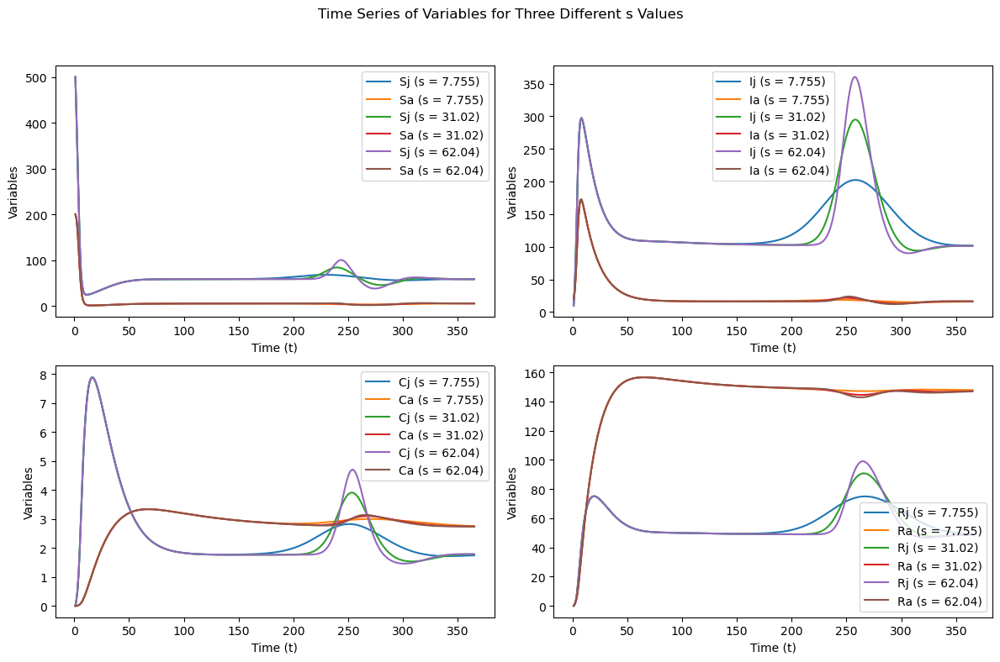

In [6]:
# Create an empty DataFrame to store results
all_results_df = pd.DataFrame(columns=['Time', 'Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra', 's'])  

# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
#middle_s_value = s_list[num_s_values // 2]  # Middle value for an odd-length list
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Create a dictionary to store data for each 's' value
data_by_s = {}

# keeping the orginal value of s and k 
s_list[8] = 31.02 
k_list[8] = 4.51/30
# Loop through both s and k simultaneously
for s, k in zip(s_list, k_list):
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 500, 10, 0, 0, 200, 20, 0, 0
    initial = [Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra]
    
    # Simulate the model
    X = odeint(model, initial, t, args=(s, k))

    # Convert simulation results to a Pandas DataFrame
    result_df = pd.DataFrame(X, columns=['Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])

    # Add a new column for s value
    result_df['s'] = s
    
    # Add the 't' values as the first column
    result_df.insert(0, 'time', t)

    # Append the simulation's DataFrame to the main DataFrame
    all_results_df = pd.concat([all_results_df, result_df], ignore_index=True)
    
    # Store data by 's' value if it's the first, middle, or last value in the 's' list
    if s == first_s_value or s == middle_s_value or s == last_s_value:
        data_by_s[s] = result_df

# Save the results to a CSV file for easy access
all_results_df.to_csv('simulation_variations_width_birth_pulse.csv', index=False)

# Create a 2x2 subplot with four panels
fig, axs = plt.subplots(2, 2, figsize=(12, 8))
fig.suptitle('Time Series of Variables for Three Different s Values')

# List of 's' values to plot
s_values_to_plot = [first_s_value, middle_s_value, last_s_value]

# Loop through the panels and variable pairs to plot
variables_to_plot = [['Sj', 'Sa'], ['Ij', 'Ia'], ['Cj', 'Ca'], ['Rj', 'Ra']]
for i in range(2):
    for j in range(2):
        variable_pair = variables_to_plot[i*2 + j]
        axs[i, j].set_xlabel('Time (t)')
        axs[i, j].set_ylabel('Variables')
        for s_value in s_values_to_plot:
            data = data_by_s[s_value]
            axs[i, j].plot(data['time'], data[variable_pair[0]], label=f'{variable_pair[0]} (s = {s_value})')
            axs[i, j].plot(data['time'], data[variable_pair[1]], label=f'{variable_pair[1]} (s = {s_value})')
        axs[i, j].legend()

# Adjust spacing between subplots
plt.tight_layout(rect=[0, 0, 1, 0.95])

# Show the plot
plt.show()


In [33]:
all_results_df

,time,Sj,Ij,Cj,Rj,Sa,Ia,Ca,Ra,s
0,1.0,500.000000,10.000000,0.000000,0.000000,200.000000,20.000000,0.000000,0.000000,7.755
1,2.0,429.919213,41.327966,0.221187,1.037680,190.971264,32.446560,0.001708,1.155738,7.755
2,3.0,341.975554,99.104062,0.583676,3.867584,165.888008,58.870097,0.008048,3.189621,7.755
3,4.0,238.540838,179.889643,1.204235,9.448199,123.481700,99.537781,0.022265,6.813252,7.755
4,5.0,144.362992,257.444741,2.128556,17.966040,76.584737,141.156723,0.049068,12.445076,7.755
...,...,...,...,...,...,...,...,...,...,...
7275,360.0,60.519646,146.924793,1.982310,72.809894,3.984571,17.363186,3.207407,196.546802,62.040
7276,361.0,60.526435,146.918806,1.982168,72.817844,3.984939,17.359204,3.206414,196.570156,62.040
7277,362.0,60.533362,146.913095,1.981989,72.824558,3.985377,17.355466,3.205427,196.593116,62.040
7278,363.0,60.540343,146.907810,1.981778,72.830170,3.985867,17.351977,3.204445,196.615682,62.040


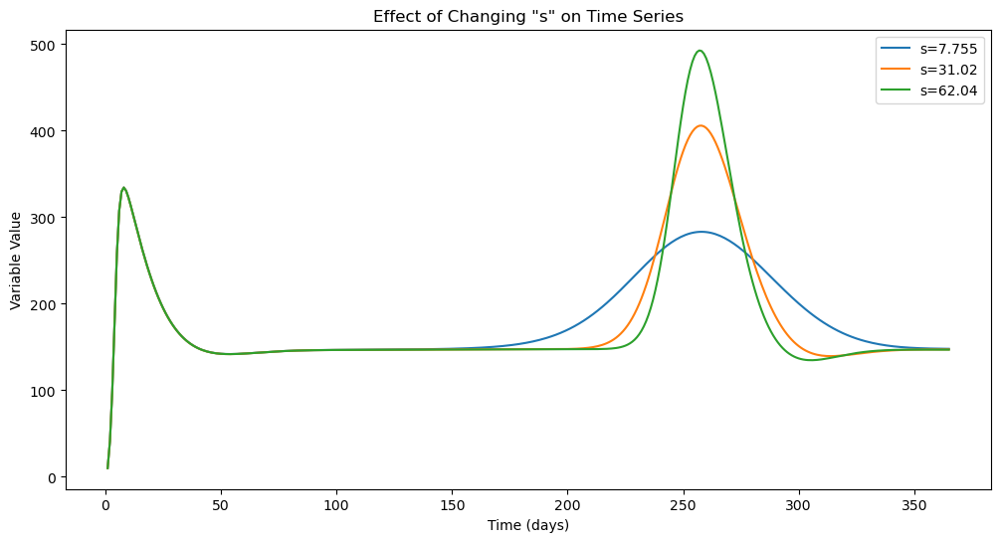

In [7]:
# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
#middle_s_value = s_list[num_s_values // 2]  # Middle value for an odd-length list
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]


# Group data by 's'
grouped = filtered_df.groupby('s')

# Create a plot for each 's' group
for s, group in grouped:
    plt.plot(group['Time'], group['Ij'], label=f's={s}')

# Customize the plot
plt.xlabel('Time (days)')
plt.ylabel('Variable Value')
plt.title('Effect of Changing "s" on Time Series')
plt.legend()

# Show or save the plot
plt.show()

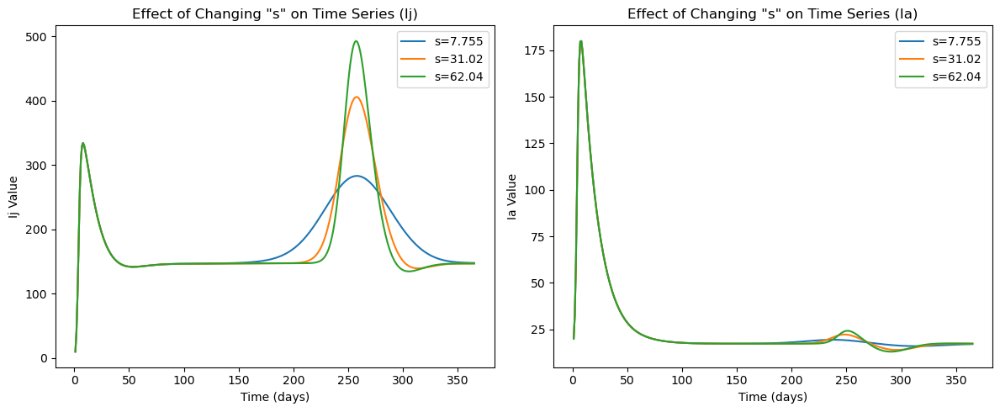

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'all_results_df' is your DataFrame
# Assuming 's_list' contains the 's' values you're interested in

# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]

# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Group data by 's' for Ij
grouped_Ij = filtered_df.groupby('s')

# Create a plot for each 's' group for Ij in the first column
for s, group in grouped_Ij:
    axes[0].plot(group['Time'], group['Ij'], label=f's={s}')

# Group data by 's' for Ia
grouped_Ia = filtered_df.groupby('s')

# Create a plot for each 's' group for Ia in the second column
for s, group in grouped_Ia:
    axes[1].plot(group['Time'], group['Ia'], label=f's={s}')

# Customize the first subplot (Ij)
axes[0].set_xlabel('Time (days)')
axes[0].set_ylabel('Ij Value')
axes[0].set_title('Effect of Changing "s" on Time Series (Ij)')
axes[0].legend()

# Customize the second subplot (Ia)
axes[1].set_xlabel('Time (days)')
axes[1].set_ylabel('Ia Value')
axes[1].set_title('Effect of Changing "s" on Time Series (Ia)')
axes[1].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show or save the plot
plt.show()


In [29]:
from ydata_profiling import ProfileReport
# Create a ProfileReport object
profile = ProfileReport(all_results_df)

# Generate the report
profile.to_file("data_profile_report_simulation_variations_width_birth_pulse.html")  # This will save the report to an HTML file

# Display the report in Jupyter Notebook (optional)
profile.to_notebook_iframe()



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Shape of your Data Set loaded: (7280, 10)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    9 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Regression problem #####################
To fix data quality issues automatically, import FixDQ from autoviz...


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Sj,float64,0.000000,NA,23.971067,500.000000,has 2308 outliers greater than upper bound (64.78) or lower than lower bound(55.22). Cap them or remove them.
Ij,float64,0.000000,NA,10.000000,492.743759,has 1299 outliers greater than upper bound (229.91) or lower than lower bound(96.35). Cap them or remove them.
Cj,float64,0.000000,NA,0.000000,9.369055,has 886 outliers greater than upper bound (4.74) or lower than lower bound(0.38). Cap them or remove them.
Rj,float64,0.000000,NA,0.000000,140.059283,has 992 outliers greater than upper bound (103.29) or lower than lower bound(54.48). Cap them or remove them.
Sa,float64,0.000000,NA,0.731287,200.000000,"has 870 outliers greater than upper bound (5.34) or lower than lower bound(1.71). Cap them or remove them., has a high correlation with ['Sj']. Consider dropping one of them."
Ia,float64,0.000000,NA,13.007764,179.911630,has 1100 outliers greater than upper bound (24.75) or lower than lower bound(12.83). Cap them or remove them.
Ca,float64,0.000000,NA,0.000000,4.386702,has 520 outliers greater than upper bound (4.81) or lower than lower bound(2.51). Cap them or remove them.
Ra,float64,0.000000,NA,0.000000,197.849931,"has 1100 outliers greater than upper bound (203.07) or lower than lower bound(186.08). Cap them or remove them., has a high correlation with ['Ia', 'Ca']. Consider dropping one of them."
s,float64,0.000000,NA,7.755000,62.040000,No issue
time,float64,0.000000,NA,1.000000,364.000000,No issue


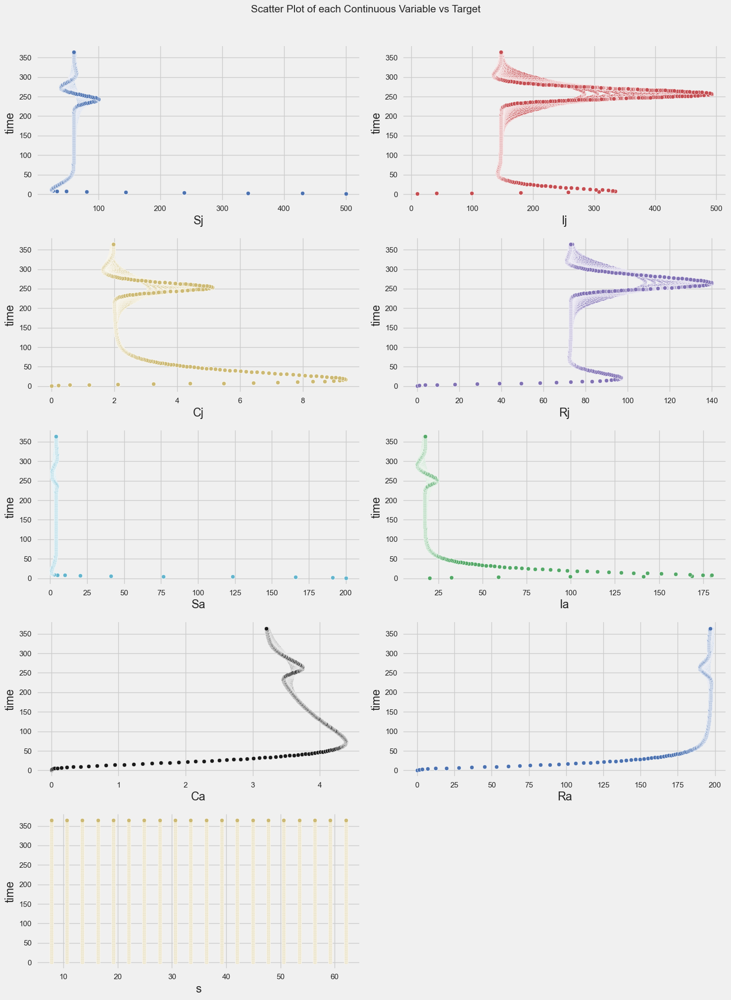

Number of All Scatter Plots = 45


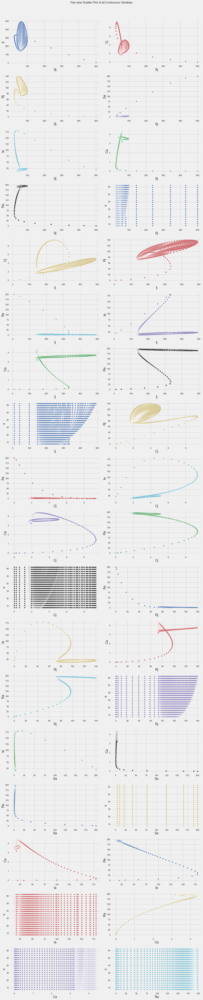

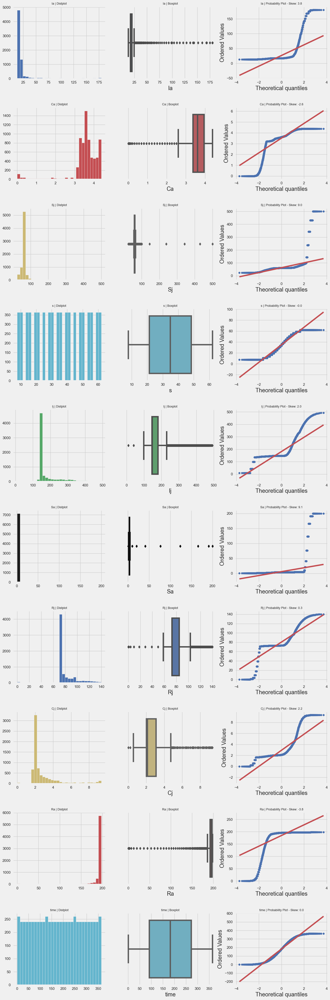

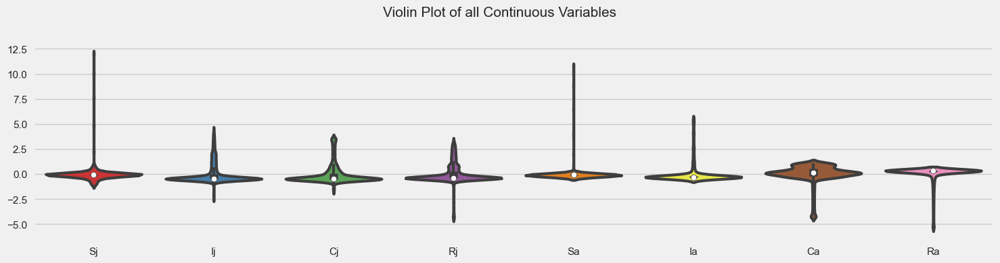

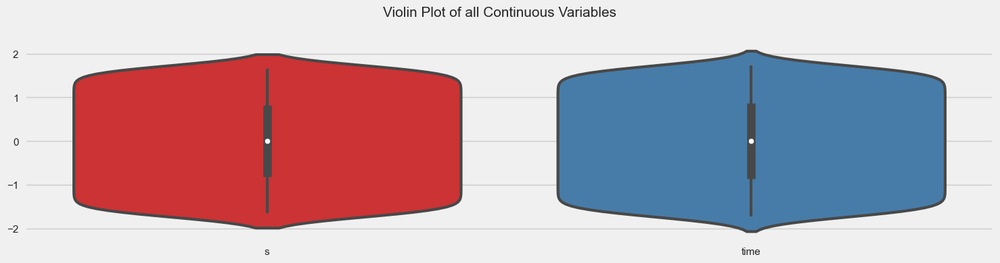

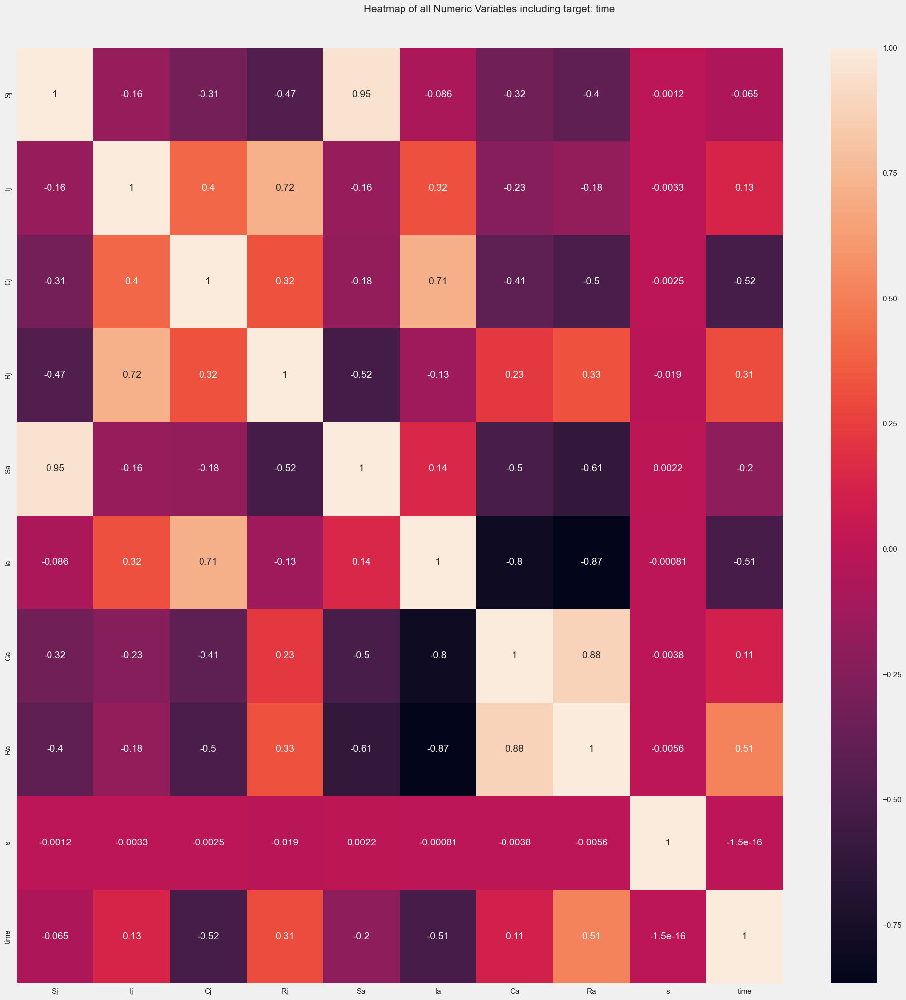

All Plots done
Time to run AutoViz = 7 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [30]:
import pandas as pd
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline
df = pd.read_csv("simulation_variations_width_birth_pulse.csv")

AV = AutoViz_Class()
dft = AV.AutoViz(
    filename="",
    sep="",
    depVar="time",
    dfte=df,
    lowess=False,
    chart_format="png",
)

 ### Make the Simulation Stochastic
 To make our simulation stochastic, we can introduce randomness into the system by adding random noise to the model equations. This will simulate the inherent variability observed in real-world systems. We can achieve this by modifying our `model` function to include stochastic elements. In the following we add stochasticity to our model using random noise:

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import trapz
from scipy.optimize import minimize
import pandas as pd

# Function to calculate nu(t) for a given shift, s, and k
def calculate_nu(t, s, k, shift_weeks=0):
    return alpha0 + k * np.exp(-s * (np.cos(np.pi * (t - shift_weeks*7) / 365 - varphi) ** 2))

# Define time range for one year (365 days)
t_one_year = np.arange(1.0, 366.0, 1)

# Initialize parameters
alpha0 = 2.77 / 30
varphi = 0.58
s_original = 31.02  # Initial value of s
k_original = 4.51 / 30  # Initial value of k

# Generate a range of s_desired values from s_original*1/4 to s_original*2
s_desired_values = np.linspace(s_original*1/4, s_original*2, num=20)

# Create an empty list to store results
results = []
# Calculate the integral of the original curve
nu_values_original = [calculate_nu(t_day, s_original, k_original) for t_day in t_one_year]
integral_original = trapz(nu_values_original, t_one_year)
print(f'Integral for Original s={s_original}, k={k_original}: {integral_original}')

# Loop through each s_desired value, optimize, and store results
for s_desired in s_desired_values:
    # Calculate the integral of the original curve
    nu_values_original = [calculate_nu(t_day, s_original, k_original) for t_day in t_one_year]
    integral_original = trapz(nu_values_original, t_one_year)

    # Function to minimize the difference in integral
    def integral_difference(params):
        s, k = params
        nu_values = [calculate_nu(t_day, s, k) for t_day in t_one_year]
        integral = trapz(nu_values, t_one_year)
        return abs(integral - integral_original)

    # Perform optimization to find the parameters that maintain the integral
    result = minimize(integral_difference, [s_desired, k_original], bounds=((0.01, 100), (0.01, 10)))

    s_optimal, k_optimal = result.x

    # Calculate and plot the original and new birth pulses with the optimized s and k
    nu_values_new = [calculate_nu(t_day, s_optimal, k_optimal) for t_day in t_one_year]

    # Append the results to the list
    results.append({'s_desired': s_desired, 'k_optimal': k_optimal, 'integral_optimal': trapz(nu_values_new, t_one_year)})

# Create a pandas dataframe from the results list
results_df = pd.DataFrame(results)

# Print the dataframe with results
#print(results_df)
s_list = list(results_df['s_desired'])
k_list = list(results_df['k_optimal'])

Integral for Original s=31.02, k=0.15033333333333332: 39.21430900858337


In [20]:
print(s_list)

[7.755, 10.612105263157893, 13.469210526315788, 16.326315789473682, 19.183421052631576, 22.04052631578947, 24.897631578947365, 27.75473684210526, 30.611842105263154, 33.46894736842105, 36.326052631578946, 39.18315789473684, 42.040263157894735, 44.897368421052626, 47.754473684210524, 50.61157894736842, 53.46868421052631, 56.3257894736842, 59.1828947368421, 62.04]


In [21]:
print(k_list)

[0.07521143098037315, 0.08729242041930182, 0.09835995522786119, 0.10844018151596096, 0.11771864685709177, 0.1263455842823451, 0.13443484934407607, 0.14207272574673188, 0.14932547882746128, 0.15625318608130415, 0.1628875944302263, 0.1692618482193593, 0.1754043657709414, 0.18133874706517936, 0.18708483849049934, 0.19265951085632807, 0.19807724723302247, 0.20335062037995666, 0.20849058484002383, 0.213506793149163]


In [12]:
import numpy as np
import pandas as pd
from scipy.integrate import odeint

# Define your constants
alpha0 = 2.77 / 30
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / 50
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Time of integration
t = np.arange(1.0, 366.0 * 1, 1)

# Function to add noise
def add_noise(value, noise_std):
    return value + np.random.normal(0, noise_std)

# Modified model function
def stochastic_model(X, t, s, k, noise_std):
    K = sum(X)  # Carrying capacity
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = X

    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * (t) / 365 - varphi) ** 2))

    dSjdt = nu * (Sa + Ra + (1 - rho) * (Ia + Ca)) - ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj) / (K ** q) - Tj * Sj - mu_j * Sj * (K / (K + 1))
    dIjdt = ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj) / (K ** q) - Tj * Ij - gamma_j * Ij - mu_j * Ij * (K / (K + 1))
    dCjdt = nu * (rho * (Ia + Ca)) - Tj * Cj - theta * mu_j * Cj * (K / (K + 1))
    dRjdt = gamma_j * Ij - Tj * Rj - mu_j * Rj * (K / (K + 1))
    dSadt = Tj * Sj - ((Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa) / (K ** q) - mu_a * Sa * (K / (K + 1))
    dIadt = ((Baa * Ia + Bja * Ij + Bc * (Cj + Ca)) * Sa) / (K ** q) - gamma_a * Ia - mu_a * Ia * (K / (K + 1))
    dCadt = Tj * Cj - theta * mu_a * Ca * (K / (K + 1))
    dRadt = gamma_a * Ia + Tj * Rj - mu_a * Ra * (K / (K + 1))

    # Apply stochasticity to relevant variables
    dSjdt = add_noise(dSjdt, noise_std)
    dIjdt = add_noise(dIjdt, noise_std)
    dCjdt = add_noise(dCjdt, noise_std)
    dRjdt = add_noise(dRjdt, noise_std)
    dSadt = add_noise(dSadt, noise_std)
    dIadt = add_noise(dIadt, noise_std)
    dCadt = add_noise(dCadt, noise_std)
    dRadt = add_noise(dRadt, noise_std)

    return [dSjdt, dIjdt, dCjdt, dRjdt, dSadt, dIadt, dCadt, dRadt]

# Set the standard deviation for the noise
noise_std = 0.1  # Adjust this value based on the desired level of stochasticity

# keeping the orginal value of s and k 
s_list[8] = 31.02 
k_list[8] = 4.51/30

all_results_df = pd.DataFrame()  # Create an empty DataFrame to store results

for s, k in zip(s_list, k_list):
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 200, 10, 5, 0, 500, 20, 10, 0
    initial = [Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra]
    
    # Simulate the model with stochasticity
    X_stochastic = odeint(stochastic_model, initial, t, args=(s, k, noise_std), atol=1e-6, rtol=1e-6)

    # Convert simulation results to a Pandas DataFrame
    result_df = pd.DataFrame(X_stochastic, columns=['Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])
    
    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * (t) / 365 - varphi) ** 2))
    result_df['nu'] = nu
    result_df['s'] = s
    
    result_df.insert(0, 'Time', t)

    all_results_df = pd.concat([all_results_df, result_df], ignore_index=True)

# Save the results to a CSV file
all_results_df.to_csv('simulation_variations_width_birth_pulse.csv', index=False)

all_results_df


/Users/rjoh331/opt/anaconda3/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/Users/rjoh331/opt/anaconda3/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/Users/rjoh331/opt/anaconda3/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/Users/rjoh331/opt/anaconda3/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

,Time,Sj,Ij,Cj,Rj,Sa,Ia,Ca,Ra,nu,s
0,1.0,2.000000e+02,1.000000e+01,5.000000e+00,0.000000e+00,5.000000e+02,2.000000e+01,1.000000e+01,0.000000e+00,0.092645,7.755
1,2.0,2.007299e+02,1.116602e+01,4.961760e+00,5.667043e-02,4.958202e+02,2.303517e+01,9.963569e+00,9.554494e-02,0.092626,7.755
2,3.0,1.315637e-312,9.233332e-02,6.948585e-310,9.233332e-02,6.948585e-310,2.546395e-313,1.315637e-312,9.233332e-02,0.092609,7.755
3,4.0,6.948585e-310,6.948585e-310,0.000000e+00,9.233333e-02,9.233333e-02,9.233333e-02,8.487983e-314,1.315637e-312,0.092593,7.755
4,5.0,4.940656e-324,6.948585e-310,9.233332e-02,6.948602e-310,9.233332e-02,9.233333e-02,8.487983e-314,1.909796e-313,0.092579,7.755
...,...,...,...,...,...,...,...,...,...,...,...
7295,361.0,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,0.092333,62.040
7296,362.0,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,0.092333,62.040
7297,363.0,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,0.092333,62.040
7298,364.0,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,1.918342e+01,0.092333,62.040


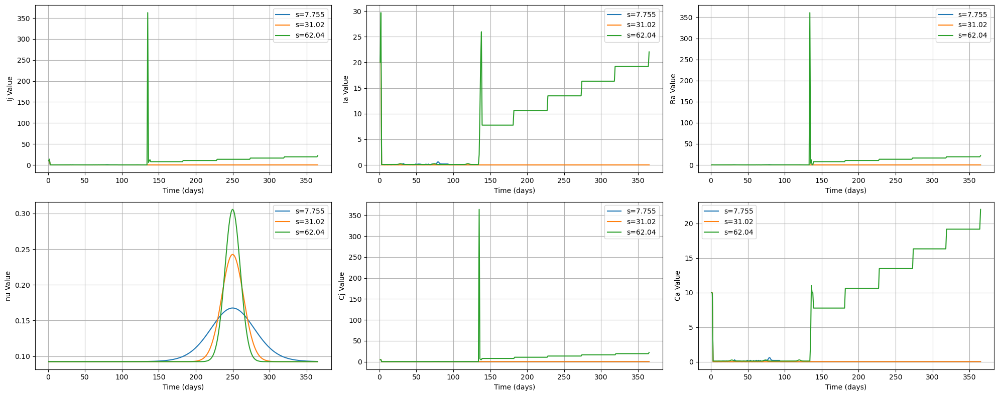

In [13]:
import matplotlib.pyplot as plt
# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]

# Create a figure with two rows and two columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 8))

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

# Create a plot for each 's' group for Ij in the first column (top row)
for s, group in grouped_data:
    axes[0, 0].plot(group['Time'], group['Ij'], label=f's={s}')
    axes[0, 1].plot(group['Time'], group['Ia'], label=f's={s}')
    axes[0, 2].plot(group['Time'], group['Ra'], label=f's={s}')
    axes[1, 0].plot(group['Time'], group['nu'], label=f's={s}')
    axes[1, 1].plot(group['Time'], group['Cj'], label=f's={s}')
    axes[1, 2].plot(group['Time'], group['Ca'], label=f's={s}')



# Add grids to all subplots
for ax in axes.flatten():
    ax.grid(True)

# Customize the first subplot (Ij)
axes[0, 0].set_xlabel('Time (days)')
axes[0, 0].set_ylabel('Ij Value')
#axes[0, 0].set_title('Effect of Changing "s" on Time Series (Ij)')
axes[0, 0].legend()
#xes[0, 0].grid(True)

# Customize the second subplot (Ia)
axes[0, 1].set_xlabel('Time (days)')
axes[0, 1].set_ylabel('Ia Value')
#axes[0, 1].set_title('Effect of Changing "s" on Time Series (Ia)')
axes[0, 1].legend()

# Customize the subplot (Ia)
axes[0, 2].set_xlabel('Time (days)')
axes[0, 2].set_ylabel('Ra Value')
axes[0, 2].legend()

# Customize the third subplot (nu)
axes[1, 0].set_xlabel('Time (days)')
axes[1, 0].set_ylabel('nu Value')
#axes[1, 0].set_title('Effect of Changing "s" on Time Series (nu)')
axes[1, 0].legend()

# Customize the fourth subplot (Cj)
axes[1, 1].set_xlabel('Time (days)')
axes[1, 1].set_ylabel('Cj Value')
#axes[1, 1].set_ylim(0, 15)
axes[1, 1].legend()

# Customize the subplot (Cj)
axes[1, 2].set_xlabel('Time (days)')
axes[1, 2].set_ylabel('Ca Value')
#axes[1, 2].set_ylim(0, 15)
axes[1, 2].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show or save the plot
plt.show()


### Code rewritten using `solve_ivp` from `SciPy`

In [35]:
import numpy as np
import pandas as pd
from scipy.integrate import solve_ivp

# Define your constants
alpha0 = 2.77 / 30
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / 50
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Time of integration
t_span = (1.0, 365.0 * 1)

# Function to add noise
def add_noise(value, noise_std):
    return value + np.random.normal(0, noise_std)

# Modified model function
def stochastic_model(t, X, s, k, noise_std):
    K = sum(X)  # Carrying capacity based on current state
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = X
    N = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra
    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * (t) / 365 - varphi) ** 2))

    dSjdt = nu * (Sa + Ra + (1 - rho) * (Ia + Ca)) - ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj) / (N ** q) - Tj * Sj - mu_j * Sj * (N / (K))
    dIjdt = ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj) / (N ** q) - Tj * Ij - gamma_j * Ij - mu_j * Ij * (N / (K))
    dCjdt = nu * (rho * (Ia + Ca)) - Tj * Cj - theta * mu_j * Cj * (N / (K))
    dRjdt = gamma_j * Ij - Tj * Rj - mu_j * Rj * (N / (K))
    dSadt = Tj * Sj - ((Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa) / (N ** q) - mu_a * Sa * (N / (K))
    dIadt = ((Baa * Ia + Bja * Ij + Bc * (Cj + Ca)) * Sa) / (N ** q) - gamma_a * Ia - mu_a * Ia * (N / (K))
    dCadt = Tj * Cj - theta * mu_a * Ca * (N / (K))
    dRadt = gamma_a * Ia + Tj * Rj - mu_a * Ra * (N / (K))

    # Apply stochasticity to relevant variables
    dSjdt = add_noise(dSjdt, noise_std)
    dIjdt = add_noise(dIjdt, noise_std)
    dCjdt = add_noise(dCjdt, noise_std)
    dRjdt = add_noise(dRjdt, noise_std)
    dSadt = add_noise(dSadt, noise_std)
    dIadt = add_noise(dIadt, noise_std)
    dCadt = add_noise(dCadt, noise_std)
    dRadt = add_noise(dRadt, noise_std)

    return [dSjdt, dIjdt, dCjdt, dRjdt, dSadt, dIadt, dCadt, dRadt]

# Set the standard deviation for the noise
noise_std = 0.5  # Adjust this value based on the desired level of stochasticity

# Initialize lists for s and k values
s_list = [7.755, 10.612105263157893, 13.469210526315788, 16.326315789473682, 19.183421052631576, 22.04052631578947, 24.897631578947365, 27.75473684210526, 30.611842105263154, 33.46894736842105, 36.326052631578946, 39.18315789473684, 42.040263157894735, 44.897368421052626, 47.754473684210524, 50.61157894736842, 53.46868421052631, 56.3257894736842, 59.1828947368421, 62.04]
k_list = [0.07521143098037315, 0.08729242041930182, 0.09835995522786119, 0.10844018151596096, 0.11771864685709177, 0.1263455842823451, 0.13443484934407607, 0.14207272574673188, 0.14932547882746128, 0.15625318608130415, 0.1628875944302263, 0.1692618482193593, 0.1754043657709414, 0.18133874706517936, 0.18708483849049934, 0.19265951085632807, 0.19807724723302247, 0.20335062037995666, 0.20849058484002383, 0.213506793149163]

all_results_df = pd.DataFrame()  # Create an empty DataFrame to store results
initial = [200, 10, 5, 0, 500, 20, 10, 0]  # Initial conditions
for s, k in zip(s_list, k_list):
    # Simulate the model with stochasticity using solve_ivp
    sol = solve_ivp(
        lambda t, y: stochastic_model(t, y, s, k, noise_std),
        t_span,
        initial,
        t_eval=np.arange(t_span[0], t_span[1] + 1, 1),
        vectorized=True,
        max_step=1  # Adjust the maximum step size as needed
    )

    # Convert simulation results to a Pandas DataFrame
    result_df = pd.DataFrame(sol.y.T, columns=['Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])
    result_df['nu'] = alpha0 + k * np.exp(-s * (np.cos(np.pi * sol.t / 365 - varphi) ** 2))
    result_df['s'] = s
    result_df.insert(0, 'Time', sol.t)

    all_results_df = pd.concat([all_results_df, result_df], ignore_index=True)

# Save the results to a CSV file
all_results_df.to_csv('simulation_variations_width_birth_pulse.csv', index=False)

all_results_df


,Time,Sj,Ij,Cj,Rj,Sa,Ia,Ca,Ra,nu,s
0,1.0,200.000000,10.000000,5.000000,0.000000,500.000000,20.000000,10.000000,0.000000,0.092645,7.755
1,2.0,197.115734,26.781762,4.603476,0.761578,451.134193,60.209809,9.863029,1.696046,0.092626,7.755
2,3.0,173.635266,63.299169,4.839843,2.479971,360.201179,139.667756,9.781990,6.188263,0.092609,7.755
3,4.0,129.823775,120.693556,5.957270,5.923794,233.308616,250.570843,9.672208,15.041053,0.092593,7.755
4,5.0,85.478164,180.340395,7.484042,11.557910,118.482284,343.859475,9.679866,28.445287,0.092579,7.755
...,...,...,...,...,...,...,...,...,...,...,...
7295,361.0,8.679257,0.019081,0.011631,0.004163,11.756088,0.136469,0.022635,2.849171,0.092333,62.040
7296,362.0,8.592498,0.026628,0.012278,0.006746,11.668833,0.120138,0.022670,2.790562,0.092333,62.040
7297,363.0,8.508177,0.033083,0.011810,0.002586,11.568300,0.111622,0.027237,2.736075,0.092333,62.040
7298,364.0,8.420822,0.031191,0.001980,0.005076,11.474307,0.112881,0.016894,2.690700,0.092333,62.040


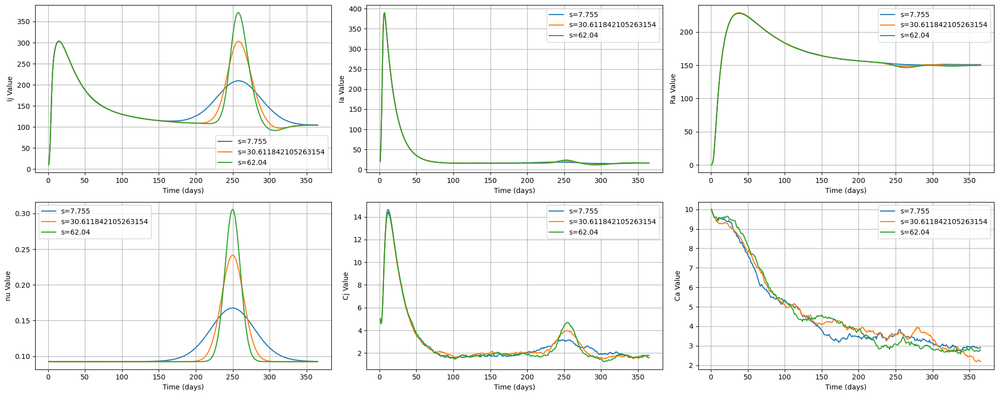

In [33]:
import matplotlib.pyplot as plt
# Get the first, middle, and last 's' values
num_s_values = len(s_list)
first_s_value = s_list[0]
middle_s_value = s_list[8]  # Middle value for an odd-length list
last_s_value = s_list[-1]

# Filter the DataFrame for the desired 's' values
filtered_df = all_results_df[all_results_df['s'].isin([first_s_value, middle_s_value, last_s_value])]

# Create a figure with two rows and two columns
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 8))

# Group data by 's' for the filtered DataFrame
grouped_data = filtered_df.groupby('s')

# Create a plot for each 's' group for Ij in the first column (top row)
for s, group in grouped_data:
    axes[0, 0].plot(group['Time'], group['Ij'], label=f's={s}')
    axes[0, 1].plot(group['Time'], group['Ia'], label=f's={s}')
    axes[0, 2].plot(group['Time'], group['Ra'], label=f's={s}')
    axes[1, 0].plot(group['Time'], group['nu'], label=f's={s}')
    axes[1, 1].plot(group['Time'], group['Cj'], label=f's={s}')
    axes[1, 2].plot(group['Time'], group['Ca'], label=f's={s}')



# Add grids to all subplots
for ax in axes.flatten():
    ax.grid(True)

# Customize the first subplot (Ij)
axes[0, 0].set_xlabel('Time (days)')
axes[0, 0].set_ylabel('Ij Value')
#axes[0, 0].set_title('Effect of Changing "s" on Time Series (Ij)')
axes[0, 0].legend()
#xes[0, 0].grid(True)

# Customize the second subplot (Ia)
axes[0, 1].set_xlabel('Time (days)')
axes[0, 1].set_ylabel('Ia Value')
#axes[0, 1].set_title('Effect of Changing "s" on Time Series (Ia)')
axes[0, 1].legend()

# Customize the subplot (Ia)
axes[0, 2].set_xlabel('Time (days)')
axes[0, 2].set_ylabel('Ra Value')
axes[0, 2].legend()

# Customize the third subplot (nu)
axes[1, 0].set_xlabel('Time (days)')
axes[1, 0].set_ylabel('nu Value')
#axes[1, 0].set_title('Effect of Changing "s" on Time Series (nu)')
axes[1, 0].legend()

# Customize the fourth subplot (Cj)
axes[1, 1].set_xlabel('Time (days)')
axes[1, 1].set_ylabel('Cj Value')
#axes[1, 1].set_ylim(0, 15)
axes[1, 1].legend()

# Customize the subplot (Cj)
axes[1, 2].set_xlabel('Time (days)')
axes[1, 2].set_ylabel('Ca Value')
#axes[1, 2].set_ylim(0, 15)
axes[1, 2].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show or save the plot
plt.show()


In [49]:
import numpy as np
import pandas as pd
from scipy.integrate import solve_ivp

# Define your constants
alpha0 = 2.77 / 30
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / 50
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Time of integration
t_end = 365.0 * 1


def compute_propensities(X, s, k):
    Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = X
    K = sum(X)  # Carrying capacity based on current state
    N = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra
    nu = alpha0 + k * np.exp(-s * (np.cos(np.pi * t / 365 - varphi) ** 2))
    
    propensities = [
        nu * (Sa + Ra + (1 - rho) * (Ia + Ca)),  # Reaction 1: Movement of Sj to Sa
        ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj) / (N ** q),  # Reaction 2: Transmission of infection from Sj to Ij
        Tj * Sj,  # Reaction 3: Recovery of Sj
        gamma_j * Ij,  # Reaction 4: Recovery of Ij
        nu * (rho * (Ia + Ca)),  # Reaction 5: Movement of Sj to Cj
        Tj * Cj,  # Reaction 6: Recovery of Cj
        gamma_a * Ia,  # Reaction 7: Recovery of Ia
        Tj * Rj,  # Reaction 8: Recovery of Rj
        ((Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa) / (N ** q),  # Reaction 9: Transmission of infection from Sa to Ia
        mu_a * Sa * (N / K),  # Reaction 10: Natural death of Sa
        mu_j * Sj * (N / K),  # Reaction 11: Natural death of Sj
        mu_j * Rj * (N / K),  # Reaction 12: Natural death of Rj
        mu_a * Ia * (N / K),  # Reaction 13: Natural death of Ia
        mu_j * Cj * (N / K),  # Reaction 14: Natural death of Cj
        mu_a * Ca * (N / K),  # Reaction 15: Natural death of Ca
        mu_a * Ra * (N / K),  # Reaction 16: Natural death of Ra
    ]
    
    return propensities


def gillespie_algorithm(X, s, k, t_end):
    t = 0
    X = X.copy()
    results = []

    while t < t_end:
        propensities = compute_propensities(X, s, k, t)
        total_propensity = sum(propensities)

        if total_propensity <= 0:
            break

        # Calculate the time until the next event
        dt = np.random.exponential(1) / total_propensity  # Ensure non-negative scale for exponential
        t += dt

        # Determine which reaction occurs
        r = np.random.uniform(0, total_propensity)
        cumulative_propensity = 0
        chosen_reaction = None

        for i, propensity in enumerate(propensities):
            cumulative_propensity += propensity
            if r <= cumulative_propensity:
                chosen_reaction = i
                break

        # Execute the chosen reaction
        if chosen_reaction is not None:
            if chosen_reaction == 0:
                # Reaction 1
                X[0] -= 1
                X[4] += 1
            elif chosen_reaction == 1:
                # Reaction 2
                X[0] -= 1
                X[1] += 1
            elif chosen_reaction == 2:
                # Reaction 3
                X[0] += 1  # Adjust based on your specific rate equation for recovery of Sj
            elif chosen_reaction == 3:
                # Reaction 4
                X[1] += 1  # Adjust based on your specific rate equation for recovery of Ij
            elif chosen_reaction == 4:
                # Reaction 5
                X[0] -= 1  # Adjust based on your specific rate equation for movement of Sj to Cj
                X[2] += 1
            elif chosen_reaction == 5:
                # Reaction 6
                X[2] -= 1  # Adjust based on your specific rate equation for recovery of Cj
            elif chosen_reaction == 6:
                # Reaction 7
                X[5] += 1  # Adjust based on your specific rate equation for recovery of Ia
            elif chosen_reaction == 7:
                # Reaction 8
                X[3] += 1  # Adjust based on your specific rate equation for recovery of Rj
            elif chosen_reaction == 8:
                # Reaction 9
                X[4] -= 1  # Adjust based on your specific rate equation for transmission of infection from Sa to Ia
                X[5] += 1
            elif chosen_reaction == 9:
                # Reaction 10
                X[4] -= 1  # Adjust based on your specific rate equation for natural death of Sa
            elif chosen_reaction == 10:
                # Reaction 11
                X[0] -= 1  # Adjust based on your specific rate equation for natural death of Sj
            elif chosen_reaction == 11:
                # Reaction 12
                X[3] -= 1  # Adjust based on your specific rate equation for natural death of Rj
            elif chosen_reaction == 12:
                # Reaction 13
                X[5] -= 1  # Adjust based on your specific rate equation for natural death of Ia
            elif chosen_reaction == 13:
                # Reaction 14
                X[2] -= 1  # Adjust based on your specific rate equation for natural death of Cj
            elif chosen_reaction == 14:
                # Reaction 15
                X[6] -= 1  # Adjust based on your specific rate equation for natural death of Ca
            elif chosen_reaction == 15:
                # Reaction 16
                X[7] -= 1  # Adjust based on your specific rate equation for natural death of Ra

        results.append([t] + X)

    return results



# Initialize results DataFrame
columns = ['Time', 'Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra']
results_df = pd.DataFrame(columns=columns)

# Initialize initial conditions
X0 = [200, 10, 5, 0, 500, 20, 10, 0]

# Initialize lists for s and k values
s_list = [7.755, 10.612105263157893, 13.469210526315788, 16.326315789473682, 19.183421052631576, 22.04052631578947, 24.897631578947365, 27.75473684210526, 30.611842105263154, 33.46894736842105, 36.326052631578946, 39.18315789473684, 42.040263157894735, 44.897368421052626, 47.754473684210524, 50.61157894736842, 53.46868421052631, 56.3257894736842, 59.1828947368421, 62.04]
k_list = [0.07521143098037315, 0.08729242041930182, 0.09835995522786119, 0.10844018151596096, 0.11771864685709177, 0.1263455842823451, 0.13443484934407607, 0.14207272574673188, 0.14932547882746128, 0.15625318608130415, 0.1628875944302263, 0.1692618482193593, 0.1754043657709414, 0.18133874706517936, 0.18708483849049934, 0.19265951085632807, 0.19807724723302247, 0.20335062037995666, 0.20849058484002383, 0.213506793149163]

# Perform Gillespie simulations for each s, k pair
for s, k in zip(s_list, k_list):
    sim_results = gillespie_algorithm(X0, s, k, t_end)
    sim_df = pd.DataFrame(sim_results, columns=columns)
    sim_df['s'] = s
    sim_df['k'] = k
    results_df = pd.concat([results_df, sim_df], ignore_index=True)

# Save the results to a CSV file
results_df.to_csv('gillespie_simulation_results.csv', index=False)

# Display the results DataFrame
results_df


TypeError: compute_propensities() takes 3 positional arguments but 4 were given

In [62]:
import numpy as np
import pandas as pd

# Define the parameters from your model
alpha0 = 2.77 / 30
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / (50)
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Time of integration
end_time = 365
timesteps = 365  # Number of timesteps
t = np.linspace(0, end_time, timesteps)

# Initialize compartments
Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 200, 10, 5, 0, 500, 20, 10, 0
K = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra

# Initialize lists to store results
S_values = [Sj]
I_values = [Ij]
R_values = [Rj]

# Define tau (time step)
tau = 1

for _ in range(timesteps - 1):
    N = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra
    infection_rate = alpha0
    recovery_rate = (gamma_j + mu_j) / (1 - rho) * Ij + (gamma_a + mu_a) / (1 - rho) * Ia
    birth_rate = mu_j * N
    death_rate_Sj = mu_j * Sj
    death_rate_Rj = mu_j * Rj
    death_rate_Ij = gamma_j * Ij
    death_rate_Sa = mu_a * Sa
    death_rate_Ra = mu_a * Ra
    death_rate_Ia = gamma_a * Ia

    # Calculate Poisson increments
    dSj = np.random.poisson(infection_rate * Sj * Ij / N * tau) - np.random.poisson(death_rate_Sj * Sj * tau)
    dIj = np.random.poisson(infection_rate * Sj * Ij / N * tau) - np.random.poisson(recovery_rate * Ij * tau) - np.random.poisson(death_rate_Ij * Ij * tau)
    dRj = np.random.poisson(recovery_rate * Ij * tau) - np.random.poisson(death_rate_Rj * Rj * tau)
    dSa = np.random.poisson(birth_rate * N * tau) - np.random.poisson(infection_rate * Sj * Ij / N * tau) - np.random.poisson(death_rate_Sa * Sa * tau)
    dIa = np.random.poisson(infection_rate * Sj * Ij / N * tau) - np.random.poisson(recovery_rate * Ia * tau) - np.random.poisson(death_rate_Ia * Ia * tau)
    dRa = np.random.poisson(recovery_rate * Ia * tau) - np.random.poisson(death_rate_Ra * Ra * tau)

    # Update compartments
    Sj += dSj
    Ij += dIj
    Rj += dRj
    Sa += dSa
    Ia += dIa
    Ra += dRa

    S_values.append(Sj)
    I_values.append(Ij)
    R_values.append(Rj)

# Create a DataFrame with the results
tau_leaping_df = pd.DataFrame({'Time': t, 'Sj': S_values, 'Ij': I_values, 'Rj': R_values})

# Save the results to a CSV file
tau_leaping_df.to_csv('tau_leaping_results.csv', index=False)


ValueError: lam value too large

In [50]:
import numpy as np
import pandas as pd

# Model parameters
beta_a_values = np.arange(1, 21, 2)
rho_a_values = np.arange(0, 1, 0.1)
end_time = 20 * 365
initials = [1000, 10, 0]  # S, I, R initial values

# Function to define the SIR model
def sir_model(beta, gamma, mu, rho, initial, end_time):
    S, I, R = initial
    S_values, I_values, R_values = [S], [I], [R]
    
    for t in range(end_time):
        N = S + I + R
        infection_rate = beta * S * I / N
        recovery_rate = (gamma + mu) / (1 - rho) * I
        birth_rate = mu * N
        death_rate_S = mu * S
        death_rate_R = mu * R
        death_rate_I = gamma * I
        
        total_rate = infection_rate + recovery_rate + birth_rate + death_rate_S + death_rate_R + death_rate_I
        
        # Calculate time to next event using exponential distribution
        time_to_event = np.random.exponential(scale=1 / total_rate)
        
        # Determine which event happens next
        event_probabilities = [infection_rate, recovery_rate, birth_rate, death_rate_S, death_rate_R, death_rate_I]
        event = np.random.choice(6, p=np.array(event_probabilities) / total_rate)
        
        # Update compartments based on the event
        if event == 0:
            S -= 1
            I += 1
        elif event == 1:
            I -= 1
            R += 1
        elif event == 2:
            S += 1
        elif event == 3:
            S -= 1
        elif event == 4:
            R -= 1
        else:
            I -= 1
        
        S_values.append(S)
        I_values.append(I)
        R_values.append(R)
    
    return S_values, I_values, R_values

# Initialize an empty DataFrame to store results
results_df = pd.DataFrame()

# Loop through different beta_a and rho_a values
for beta_a in beta_a_values:
    for rho_a in rho_a_values:
        # Call the SIR model with the specified parameters
        S, I, R = sir_model(beta_a, 1/20, 1/50, rho_a, initials, end_time)
        
        # Create a DataFrame with the results
        df = pd.DataFrame({'Time': range(end_time+1), 'S': S, 'I': I, 'R': R,
                           'Beta_a': beta_a, 'Rho_a': rho_a})
        
        # Append the results to the main DataFrame
        results_df = pd.concat([results_df, df], ignore_index=True)

# Save the results to a CSV file
results_df.to_csv('sir_model_results.csv', index=False)


/var/folders/tt/5m471nxs2815sn_md1rbdvxdb8phhw/T/ipykernel_20235/4137534574.py:69: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(df, ignore_index=True)


In [51]:
results_df

,Time,S,I,R,Beta_a,Rho_a
0,0,1000,10,0,1,0.0
1,1,999,10,0,1,0.0
2,2,998,11,0,1,0.0
3,3,997,11,0,1,0.0
4,4,996,11,0,1,0.0
...,...,...,...,...,...,...
730095,7296,41,35,853,19,0.9
730096,7297,40,36,853,19,0.9
730097,7298,40,35,854,19,0.9
730098,7299,39,36,854,19,0.9


In [63]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Model parameters (same as your provided parameters)
alpha0 = 2.77 / 30
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / 50
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Initial conditions (modify as needed)
Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 200, 10, 5, 0, 500, 20, 10, 0
N = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra

# Time parameters
t_end = 365
t = 0
results = []

# Gillespie algorithm with tau-leaping
while t < t_end:
    nu = alpha0  # Calculate nu based on your formula (you can modify this)
    rates = [
        nu * (Sa + Ra + (1 - rho) * (Ia + Ca)),
        (Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Sj + mu_j * Sj * (N / N),
        (Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Ij + gamma_j * Ij + mu_j * Ij * (N / N),
        nu * (rho * (Ia + Ca)) + Tj * Cj + theta * mu_j * Cj * (N / N),
        gamma_j * Ij + Tj * Rj + mu_j * Rj * (N / N),
        Tj * Sj + (Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + mu_a * Sa * (N / N),
        (Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + gamma_a * Ia + mu_a * Ia * (N / N),
        Tj * Cj + theta * mu_a * Ca * (N / N),
        gamma_a * Ia + Tj * Ra + mu_a * Ra * (N / N),
    ]

    # Calculate the tau parameter (you can modify this)
    tau = np.min([np.random.exponential(1 / rate) for rate in rates])

    # Calculate the change in each population using tau-leaping (you can modify this)
    delta_Sj = (nu * (Sa + Ra + (1 - rho) * (Ia + Ca)) - ((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Sj + mu_j * Sj * (N / N))) * tau
    delta_Ij = (((Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Sj + mu_j * Sj * (N / N)) - (Tj * Ij + gamma_j * Ij + mu_j * Rj * (N / N))) * tau
    delta_Cj = (nu * (rho * (Ia + Ca)) - (Tj * Cj + theta * mu_j * Cj * (N / N))) * tau
    delta_Rj = (gamma_j * Ij - (Tj * Rj + mu_j * Rj * (N / N))) * tau
    delta_Sa = (Tj * Sj - ((Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + mu_a * Sa * (N / N))) * tau
    delta_Ia = (((Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + gamma_a * Ia + mu_a * Ia * (N / N)) - (mu_a * Ia * (N / N))) * tau
    delta_Ca = (Tj * Cj - (theta * mu_a * Ca * (N / N))) * tau
    delta_Ra = (gamma_a * Ia + Tj * Ra - (mu_a * Ra * (N / N))) * tau

    # Update the populations
    Sj += delta_Sj
    Ij += delta_Ij
    Cj += delta_Cj
    Rj += delta_Rj
    Sa += delta_Sa
    Ia += delta_Ia
    Ca += delta_Ca
    Ra += delta_Ra

    # Update time
    t += tau

    # Append results to the list
    results.append([t, Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra])

# Convert results to a DataFrame for easy visualization and analysis
result_df = pd.DataFrame(results, columns=['Time', 'Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])

# Save the results to a CSV file
result_df.to_csv('gillespie_tau_leaping_simulation.csv', index=False)

# Visualize the results (you can modify this)
plt.figure(figsize=(12, 6))
plt.plot(result_df['Time'], result_df['Sj'], label='Sj')
plt.plot(result_df['Time'], result_df['Ij'], label='Ij')
plt.plot(result_df['Time'], result_df['Cj'], label='Cj')
plt.plot(result_df['Time'], result_df['Rj'], label='Rj')
plt.plot(result_df['Time'], result_df['Sa'], label='Sa')
plt.plot(result_df['Time'], result_df['Ia'], label='Ia')
plt.plot(result_df['Time'], result_df['Ca'], label='Ca')
plt.plot(result_df['Time'], result_df['Ra'], label='Ra')
plt.xlabel('Time')
plt.ylabel('Population')
plt.legend()
plt.title('Gillespie Algorithm with Tau-Leaping Simulation')
plt.show


KeyboardInterrupt: 

In [66]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Model parameters (same as your provided parameters)
alpha0 = 2.77 / 30
k=4.51/30 # 55.60
s=31.02 #26.04
varphi = 0.58
Bjj = 1.45e-3
Bja = 1.45e-3
Baa = 1.45e-3
Bc = (1.45e-3) / 2
rho = 0.1
theta = 1.05
Tj = 0.0166
mu_j = 0.15
mu_a = 1 / 50
gamma_j = 0.0457
gamma_a = 0.0457
q = 0

# Initial conditions (modify as needed)
Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra = 200, 10, 5, 0, 500, 20, 10, 0
N = Sj + Ij + Cj + Rj + Sa + Ia + Ca + Ra

# Time parameters
t_end = 365
t = 0
results = []

# Gillespie algorithm with stochasticity
while t < t_end:
    nu = alpha0  # Calculate nu based on your formula (you can modify this)
    rates = [
        nu * (Sa + Ra + (1 - rho) * (Ia + Ca)),
        (Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Sj + mu_j * Sj * (N / N),
        (Bja * Ia + Bjj * Ij + Bc * (Cj + Ca)) * Sj / (N ** q) + Tj * Ij + gamma_j * Ij + mu_j * Ij * (N / N),
        nu * (rho * (Ia + Ca)) + Tj * Cj + theta * mu_j * Cj * (N / N),
        gamma_j * Ij + Tj * Rj + mu_j * Rj * (N / N),
        Tj * Sj + (Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + mu_a * Sa * (N / N),
        (Baa * Ia + Bja * Ij + Bc * (Ca + Cj)) * Sa / (N ** q) + gamma_a * Ia + mu_a * Ia * (N / N),
        Tj * Cj + theta * mu_a * Ca * (N / N),
        gamma_a * Ia + Tj * Ra + mu_a * Ra * (N / N),
    ]

    # Calculate the total rate
    total_rate = sum(rates)

    # Generate a random time step based on exponential distribution
    tau = np.random.exponential(1 / total_rate)

    # Determine the event that happens next based on probabilities
    event_probabilities = [rate / total_rate for rate in rates]

    # Correct for potential floating-point errors that may cause sum(event_probabilities) != 1
    total_prob = sum(event_probabilities)
    if total_prob > 0:
        event_probabilities = [prob / total_prob for prob in event_probabilities]

    event = np.random.choice(range(len(rates)), p=event_probabilities)

    # Update the populations based on the selected event
    if event == 0:
        # Event 0: Update Sj, Sa
        delta_Sj = -1
        delta_Sa = 1
    elif event == 1:
        # Event 1: Update Sj, Ij
        delta_Sj = -1
        delta_Ij = 1
    # Add more conditions for other events as needed...

    # Update the populations
    Sj += delta_Sj
    Ij += delta_Ij
    Cj += delta_Cj
    Rj += delta_Rj
    Sa += delta_Sa
    Ia += delta_Ia
    Ca += delta_Ca
    Ra += delta_Ra

    # Update time
    t += tau

    # Append results to the list
    results.append([t, Sj, Ij, Cj, Rj, Sa, Ia, Ca, Ra])

# Convert results to a DataFrame for easy visualization and analysis
result_df = pd.DataFrame(results, columns=['Time', 'Sj', 'Ij', 'Cj', 'Rj', 'Sa', 'Ia', 'Ca', 'Ra'])

# Save the results to a CSV file
result_df.to_csv('stochastic_gillespie_simulation.csv', index=False)

# Visualize the results (you can modify this)
plt.figure(figsize=(12, 6))
plt.plot(result_df['Time'], result_df['Sj'], label='Sj')
plt.plot(result_df['Time'], result_df['Ij'], label='Ij')
plt.plot(result_df['Time'], result_df['Cj'], label='Cj')
plt.plot(result_df['Time'], result_df['Rj'], label='Rj')
plt.plot(result_df['Time'], result_df['Sa'], label='Sa')
plt.plot(result_df['Time'], result_df['Ia'], label='Ia')
plt.plot(result_df['Time'], result_df['Ca'], label='Ca')
plt.plot(result_df['Time'], result_df['Ra'], label='Ra')
plt.xlabel('Time')
plt.ylabel('Population')
plt.legend()
plt.title('Stochastic Gillespie Algorithm Simulation')
plt.show()


ValueError: probabilities are not non-negative